# Getting Data:  Working with APIs, TEXT analytics & Census

- (part 1) **Introduction to APIs**
- (part 2) **Natural language processing via Philly's 311 API**
    - Word frequencies
    - Sentiment analysis
- (part 3) Pulling **census** data and shape files using Python

In [83]:
import geopandas as gpd
import holoviews as hv
import hvplot.pandas
import numpy as np
import pandas as pd
import seaborn as sns
from matplotlib import pyplot as plt
# Show all columns
pd.options.display.max_columns = 999

# PART 1: Introduction to APIs

Or, how to pull data from the web using Python

**Application programming interface (API):**

> (noun): A particular set of rules and specifications that software programs can follow to communicate with each other and exchange data.

**Example APIs**

- Socrata Open Data: [https://dev.socrata.com/](https://dev.socrata.com/)
- Open Data Philly: [https://opendataphilly.org](https://opendataphilly.org)
- US Census Bureau: [https://www.census.gov/data/developers/data-sets.html](https://www.census.gov/data/developers/data-sets.html)
- Bureau of Labor Statistics: [https://www.bls.gov/developers/](https://www.bls.gov/developers/)
- US Geological Survey: [https://www.usgs.gov/products/data-and-tools/apis](https://www.usgs.gov/products/data-and-tools/apis)
- US Environmental Protection Agency: [https://www.epa.gov/enviro/web-services](https://www.epa.gov/enviro/web-services)
- Google APIs: [https://console.cloud.google.com/apis/library](https://console.cloud.google.com/apis/library)
- Facebook: [https://developers.facebook.com/docs/apis-and-sdks/](https://developers.facebook.com/docs/apis-and-sdks/)
- Twitter: [https://developer.twitter.com/en/docs/api-reference-index.html](https://developer.twitter.com/en/docs/api-reference-index) (RIP 💀)
- Foursquare: [https://developer.foursquare.com/](https://developer.foursquare.com/)
- Instagram: [https://www.instagram.com/developer/](https://www.instagram.com/developer/)
- Yelp: [https://www.yelp.com/developers](https://www.instagram.com/developer/)

When accessing data via API, many services will require you to register an API key to prevent you from overloading the service with requests.

###  Example #1: Automated data feeds

The simplest form of API is when data providers maintain data files via a URL that are automatically updated with new data over time. 

#### USGS real-time earthquake feeds

This is an API for near-real-time data about earthquakes, and data is provided in GeoJSON format over the web. 

The API has a separate endpoint for each version of the data that users might want. No authentication is required.

API documentation:

[http://earthquake.usgs.gov/earthquakes/feed/v1.0/geojson.php](http://earthquake.usgs.gov/earthquakes/feed/v1.0/geojson.php)

Sample API endpoint, for magnitude 4.5+ earthquakes in past day:

[http://earthquake.usgs.gov/earthquakes/feed/v1.0/summary/4.5_day.geojson](http://earthquake.usgs.gov/earthquakes/feed/v1.0/summary/4.5_day.geojson)

In [84]:
# Download data on magnitude 2.5+ quakes from the past week
endpoint_url = (
    "http://earthquake.usgs.gov/earthquakes/feed/v1.0/summary/2.5_week.geojson"
)
earthquakes = gpd.read_file(endpoint_url)

In [85]:
earthquakes.head()

,id,mag,place,time,updated,tz,url,detail,felt,cdi,mmi,alert,status,tsunami,sig,net,code,ids,sources,types,nst,dmin,rms,gap,magType,type,title,geometry
0,us7000np8h,3.50,"20 km SE of Baláo, Ecuador",1730398453974,1730400060040,None,https://earthquake.usgs.gov/earthquakes/eventp...,https://earthquake.usgs.gov/earthquakes/feed/v...,NaN,NaN,NaN,None,reviewed,0,188,us,7000np8h,",us7000np8h,",",us,",",origin,phase-data,",9.0,0.72500,0.23,333.0,ml,earthquake,"M 3.5 - 20 km SE of Baláo, Ecuador",POINT Z (-79.69370 -3.04890 10.00000)
1,us7000np8b,5.30,"68 km S of Panguna, Papua New Guinea",1730396788610,1730397918040,None,https://earthquake.usgs.gov/earthquakes/eventp...,https://earthquake.usgs.gov/earthquakes/feed/v...,NaN,NaN,NaN,None,reviewed,0,432,us,7000np8b,",us7000np8b,",",us,",",moment-tensor,origin,phase-data,",79.0,4.25100,0.60,34.0,mww,earthquake,"M 5.3 - 68 km S of Panguna, Papua New Guinea",POINT Z (155.43950 -6.93700 50.58200)
2,ak024e0p56du,3.80,"36 km W of Akhiok, Alaska",1730395126566,1730398947815,None,https://earthquake.usgs.gov/earthquakes/eventp...,https://earthquake.usgs.gov/earthquakes/feed/v...,1.0,3.4,2.728,None,automatic,0,222,ak,024e0p56du,",ak024e0p56du,us7000np87,",",ak,us,",",dyfi,origin,phase-data,shakemap,",NaN,NaN,0.74,NaN,ml,earthquake,"M 3.8 - 36 km W of Akhiok, Alaska",POINT Z (-154.76050 56.98930 25.70000)
3,nc75081401,3.29,"3 km NNW of The Geysers, CA",1730394866310,1730397213635,None,https://earthquake.usgs.gov/earthquakes/eventp...,https://earthquake.usgs.gov/earthquakes/feed/v...,16.0,4.0,NaN,None,automatic,0,173,nc,75081401,",nc75081401,us7000np86,",",nc,us,",",dyfi,focal-mechanism,nearby-cities,origin,pha...",78.0,0.01100,0.08,45.0,ml,earthquake,"M 3.3 - 3 km NNW of The Geysers, CA",POINT Z (-122.77683 38.80267 3.77000)
4,pr71464308,2.56,"4 km SSE of Maria Antonia, Puerto Rico",1730391607320,1730392968720,None,https://earthquake.usgs.gov/earthquakes/eventp...,https://earthquake.usgs.gov/earthquakes/feed/v...,NaN,NaN,NaN,None,reviewed,0,101,pr,71464308,",pr71464308,",",pr,",",origin,phase-data,",14.0,0.03471,0.21,200.0,md,earthquake,"M 2.6 - 4 km SSE of Maria Antonia, Puerto Rico",POINT Z (-66.87300 17.94067 6.98000)


In [86]:
earthquakes.explore()

Lots of other automated feeds available, updated every minute:

![](imgs/usgs-1.png)
![](imgs/usgs-2.png)

### Example #2: The CARTO API

- Philadelphia hosts the majority of its open data on OpenDataPhilly in the cloud using CARTO
- They provide an API to download the data
- You can access the API documentation on the dataset page on OpenDataPhilly

- For example: shooting victims in Philadelphia

[https://www.opendataphilly.org/dataset/shooting-victims](https://www.opendataphilly.org/dataset/shooting-victims)

and the API documentation:

[https://cityofphiladelphia.github.io/carto-api-explorer/#shootings](https://cityofphiladelphia.github.io/carto-api-explorer/#shootings)

#### The anatomy of an API request

![](imgs/carto-api.png){width="600"}

- **Base URL**: shown in blue
- **?**: shown in purple; it separates the base URL from the query parameters
- **Query parameters**: underlined in red; these parameters allow the user to customize the data response
- **&**: underlined in green; the separator between the query parameters

- So, let's break down the URL into its component parts:

In [87]:
# The API endpoint
carto_api_endpoint = "https://phl.carto.com/api/v2/sql"

# The query parameters
params = {
    "q": "SELECT * FROM shootings",
    "format": "geojson",
    "skipfields": "cartodb_id",
    # Note: we won't need the filename parameter, since we're not saving the data to a file
    # "filename": "shootings"
}

### Note: SQL Queries

The `q` parameter is a *SQL query*. It allows you to select a specific subset of data from the larger database.

CARTO API documentation: [https://carto.com/developers/sql-api/](https://carto.com/developers/sql-api/)

SQL documentation: [https://www.postgresql.org/docs/9.1/sql.html](https://www.postgresql.org/docs/9.1/sql.html)

**General Query Syntax**

`SELECT [field names] FROM [table name] WHERE [query]`

#### Let's try it out in Python

We'll use Python's `requests` library to use a "get" request to query the API endpoint with our desired query. Similar to our web scraping requests!

In [88]:
import requests

Let's make the get request and pass the query parameters via the `params` keyword:

In [89]:
response = requests.get(carto_api_endpoint, params=params)

response

<Response [200]>

In [90]:
# Get the returned data in JSON format
# This is a dictionary
features = response.json()

In [91]:
type(features)

dict

In [92]:
# What are the keys?
list(features.keys())

['type', 'features']

In [93]:
features["type"]

'FeatureCollection'

In [94]:
# Let's look at the first feature
features["features"][0]

{'type': 'Feature',
 'geometry': {'type': 'Point', 'coordinates': [-75.1553, 40.000266]},
 'properties': {'objectid': 15856163,
  'year': 2020,
  'dc_key': '202039052863.0',
  'code': '400',
  'date_': '2020-08-31T00:00:00Z',
  'time': '00:59:00',
  'race': 'B',
  'sex': 'F',
  'age': '28',
  'wound': 'Leg',
  'officer_involved': 'N',
  'offender_injured': 'N',
  'offender_deceased': 'N',
  'location': '1500 BLOCK W CLEARFIELD ST',
  'latino': 0,
  'point_x': -75.1552996,
  'point_y': 40.00026609,
  'dist': '39',
  'inside': 0,
  'outside': 1,
  'fatal': 0}}

In [95]:
shootings = gpd.GeoDataFrame.from_features(features, crs="EPSG:4326")

Don't forget to specify the CRS of the input data when using `GeoDataFrame.from_features()`.

In [96]:
shootings.head()

,geometry,objectid,year,dc_key,code,date_,time,race,sex,age,wound,officer_involved,offender_injured,offender_deceased,location,latino,point_x,point_y,dist,inside,outside,fatal
0,POINT (-75.15530 40.00027),15856163,2020,202039052863.0,400,2020-08-31T00:00:00Z,00:59:00,B,F,28,Leg,N,N,N,1500 BLOCK W CLEARFIELD ST,0.0,-75.155300,40.000266,39,0.0,1.0,0.0
1,POINT (-75.17325 39.99643),15856164,2020,202039060858.0,400,2020-10-07T00:00:00Z,23:10:00,B,M,21,Hand,N,N,N,2500 BLOCK W LEHIGH AVE,0.0,-75.173248,39.996433,39,0.0,1.0,0.0
2,POINT (-75.17047 40.02774),15856165,2020,202039051760.0,100,2020-08-25T00:00:00Z,13:23:00,B,M,34,Head,N,N,N,5100 BLOCK HENLEY ST,0.0,-75.170468,40.027737,39,0.0,1.0,1.0
3,POINT (-75.15530 40.00027),15856166,2020,202039052864.0,400,2020-08-31T00:00:00Z,00:59:00,B,M,31,Buttocks,N,N,N,1500W CLEARFIELD ST,0.0,-75.155300,40.000266,39,0.0,1.0,0.0
4,POINT (-75.17115 39.99705),15856167,2020,202039053032.0,400,2020-08-31T00:00:00Z,01:53:00,B,M,28,Back,N,N,N,2700 BLOCK N RINGGOLD ST,0.0,-75.171155,39.997052,39,0.0,1.0,0.0


#### At-Home Exercise: Visualizing shootings data
**Step 1: Prep the data**

- Drop rows where the geometry is NaN
- Convert to a better CRS (e.g., 3857)
- Load city limits from Open Data Philly and trim to those only within city limits (some shootings have wrong coordinates, outside Philadelphia!)

In [97]:
# make sure we remove missing geometries
shootings = shootings.dropna(subset=["geometry"])

# convert to a better CRS
shootings = shootings.to_crs(epsg=3857)

In [98]:
city_limits = gpd.read_file(
    "https://opendata.arcgis.com/datasets/405ec3da942d4e20869d4e1449a2be48_0.geojson"
).to_crs(epsg=3857)

In [99]:
# Remove any shootings that are outside the city limits
shootings = gpd.sjoin(shootings, city_limits, predicate="within", how="inner").drop(
    columns=["index_right"]
)

**Step 2: Plot the points**

A quick plot with geopandas to show the shootings as points, and overlay Philadelphia ZIP codes.

In [100]:
# From Open Data Philly
zip_codes = gpd.read_file(
    "https://opendata.arcgis.com/datasets/b54ec5210cee41c3a884c9086f7af1be_0.geojson"
).to_crs(epsg=3857)

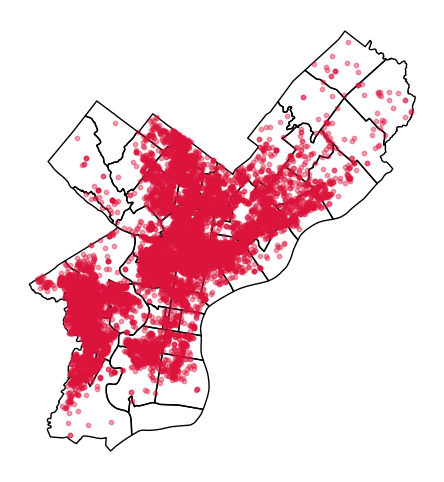

In [101]:
fig, ax = plt.subplots(figsize=(6, 6))

# ZIP Codes
zip_codes.to_crs(epsg=3857).plot(ax=ax, facecolor="none", edgecolor="black")

# Shootings
shootings.plot(ax=ax, color="crimson", markersize=10, alpha=0.4)
ax.set_axis_off()

**Step 3: Make a (more useful) hex bin map**

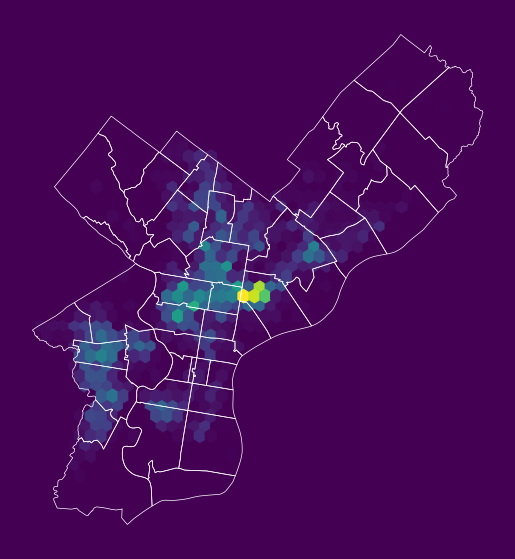

In [102]:
# Initialize the axes
fig, ax = plt.subplots(figsize=(7, 7), facecolor=plt.get_cmap("viridis")(0))

# Convert to Web Mercator and plot the hexbins
x = shootings.geometry.x
y = shootings.geometry.y
ax.hexbin(x, y, gridsize=40, mincnt=1, cmap="viridis")

# overlay the city limits
zip_codes.to_crs(epsg=3857).plot(
    ax=ax, facecolor="none", linewidth=0.5, edgecolor="white"
)

ax.set_axis_off()

#### Example: Count the total number of rows in a table

The SQL `COUNT` function can be applied to count all rows.

In [103]:
response = requests.get(
    carto_api_endpoint, params={"q": "SELECT COUNT(*) FROM shootings"}
)

In [104]:
response.json()

{'rows': [{'count': 16269}],
 'time': 0.011,
 'fields': {'count': {'type': 'number', 'pgtype': 'int8'}},
 'total_rows': 1}

#### Example: Select all columns, limiting the total number returned

The `LIMIT` function limits the number of returned rows. It is very useful for taking a quick look at the format of a database.

In [105]:
# Limit the returned data to only 1 row
query = "SELECT * FROM shootings LIMIT 1"

# Make the request
params = {"q": query, "format": "geojson"}
response = requests.get(carto_api_endpoint, params=params)

Create the GeoDataFrame:

In [106]:
df = gpd.GeoDataFrame.from_features(response.json(), crs="EPSG:4326")

df

,geometry,cartodb_id,objectid,year,dc_key,code,date_,time,race,sex,age,wound,officer_involved,offender_injured,offender_deceased,location,latino,point_x,point_y,dist,inside,outside,fatal
0,POINT (-75.15530 40.00027),1,15856163,2020,202039052863.0,400,2020-08-31T00:00:00Z,00:59:00,B,F,28,Leg,N,N,N,1500 BLOCK W CLEARFIELD ST,0,-75.1553,40.000266,39,0,1,0


#### Example: Select by specific column values

Use the `WHERE` function to select a subset where the logical condition is true.

Example #1: Select nonfatal shootings only

# Select nonfatal shootings only
query = "SELECT * FROM shootings WHERE fatal = 0"

In [107]:
# Make the request
params = {"q": query, "format": "geojson"}
response = requests.get(carto_api_endpoint, params=params)

# Make the GeoDataFrame
nonfatal = gpd.GeoDataFrame.from_features(response.json(), crs="EPSG:4326")

# Print
print("number of nonfatal shootings = ", len(nonfatal))

number of nonfatal shootings =  1


In [110]:
#Example #2: Select shootings in 2023

In [111]:
# Make the request
params = {"q": query, "format": "geojson"}
response = requests.get(carto_api_endpoint, params=params)

# Make the GeoDataFrame
shootings_2023 = gpd.GeoDataFrame.from_features(response.json(), crs="EPSG:4326")

# Print
print("number of shootings in 2023 = ", len(shootings_2023))

number of shootings in 2023 =  1


#### At-Home Exercise: Explore trends by month and day of week

##### Step 1: Convert the date column to `DateTime` objects

Add Month and Day of Week columns

In [112]:
# Condddvert the data column to a datetime object
shootings["date"] = pd.to_datetime(shootings["date_"])

# Add new columns: Month and Day of Week
shootings["Month"] = shootings["date"].dt.month
shootings["Day of Week"] = shootings["date"].dt.dayofweek  # Monday is 0, Sunday is 6

##### Step 2: Calculate number of shootings by month and day of week

Use the familiar Groupby --> size()

In [113]:
count = shootings.groupby(["Month", "Day of Week"]).size()
count = count.reset_index(name="Count")
count.head()

,Month,Day of Week,Count
0,1,0,180
1,1,1,165
2,1,2,152
3,1,3,159
4,1,4,156


##### Step 3: Make a heatmap using `hvplot`

In [114]:
# Remember 0 is Monday and 6 is Sunday
count.hvplot.heatmap(
    x="Day of Week",
    y="Month",
    C="Count",
    cmap="viridis",
    width=400,
    height=500,
    flip_yaxis=True,
)

:HeatMap   [Day of Week,Month]   (Count)

**Trends:** more shootings on the weekends and in the summer months

## Part 2: Natural Language Processing and the 311 Request API

In part two, we'll pull data using the API for the Philly 311 system, available at: [https://iframe.publicstuff.com/#?client_id=242](https://iframe.publicstuff.com/#?client_id=242)

We saw this site previously when we talked about web scraping last week:

![](imgs/philly-311.png)


Let's take another look at the address where the site is pulling its data from:

`https://vc0.publicstuff.com/api/2.0/requests_list?client_id=242&device=iframe&limit=35&page=1`


This is just an **API request!** It's an example of a *non-public, internal* API, but we can reverse-engineer it to extract the data we want!

Break it down into it's component parts:

- **Base URL:** [https://vc0.publicstuff.com/api/2.0/requests_list](https://vc0.publicstuff.com/api/2.0/requests_list)
- **Query parameters:** client_id, device, limit, page

It looks likes "client_id" identifies data for the City of Philadelphia, which is definitely a required parameter. Otherwise, the other parameters seem optional, returning the requests on a certain device and viewing page.


Let's test it out. We'll grab 2 requests from the first page:

In [115]:
r = requests.get(
    "https://vc0.publicstuff.com/api/2.0/requests_list",
    params={"client_id": 242, "page": 1, "limit": 2},
)
json = r.json()
json

{'response': {'requests': [{'request': {'id': 16169377,
     'image_thumbnail': '',
     'title': 'Construction Complaint',
     'description': 'Causing a fire hazard and carbon monoxide hazard for near neighbors by using a gas powered generator indoors. Fire department had to come and stop them and inspect neighboring properties ',
     'status': 'submitted',
     'address': '1252 S 15th St,Philadelphia, PA 19146',
     'location': 'Philadelphia, Pennsylvania',
     'zipcode': '19146',
     'foreign_id': '17245015',
     'date_created': 1730402587,
     'count_comments': 0,
     'count_followers': 0,
     'count_supporters': 0,
     'lat': 39.934572,
     'lon': -75.169443,
     'user_follows': 0,
     'user_comments': 0,
     'user_request': 0,
     'rank': '1',
     'user': ''}},
   {'request': {'id': 16169330,
     'image_thumbnail': '',
     'title': 'Dangerous Sidewalk',
     'description': "There is a narrow strip of sidewalk corresponding to the plumbing connection to the house

Now we need to understand the structure of the response. First, access the list of requests:

In [116]:
request_list = json["response"]["requests"]

request_list

[{'request': {'id': 16169377,
   'image_thumbnail': '',
   'title': 'Construction Complaint',
   'description': 'Causing a fire hazard and carbon monoxide hazard for near neighbors by using a gas powered generator indoors. Fire department had to come and stop them and inspect neighboring properties ',
   'status': 'submitted',
   'address': '1252 S 15th St,Philadelphia, PA 19146',
   'location': 'Philadelphia, Pennsylvania',
   'zipcode': '19146',
   'foreign_id': '17245015',
   'date_created': 1730402587,
   'count_comments': 0,
   'count_followers': 0,
   'count_supporters': 0,
   'lat': 39.934572,
   'lon': -75.169443,
   'user_follows': 0,
   'user_comments': 0,
   'user_request': 0,
   'rank': '1',
   'user': ''}},
 {'request': {'id': 16169330,
   'image_thumbnail': '',
   'title': 'Dangerous Sidewalk',
   'description': "There is a narrow strip of sidewalk corresponding to the plumbing connection to the house at 4220 Baltimore Avenue, dug up by (I believe from conversation with t

We need to extract out the "request" key of each list entry. Let's do that and create a DataFrame:

In [117]:
data = pd.DataFrame([r["request"] for r in request_list])
data.head()

,id,image_thumbnail,title,description,status,address,location,zipcode,foreign_id,date_created,count_comments,count_followers,count_supporters,lat,lon,user_follows,user_comments,user_request,rank,user
0,16169377,,Construction Complaint,Causing a fire hazard and carbon monoxide haza...,submitted,"1252 S 15th St,Philadelphia, PA 19146","Philadelphia, Pennsylvania",19146,17245015,1730402587,0,0,0,39.934572,-75.169443,0,0,0,1,
1,16169330,,Dangerous Sidewalk,There is a narrow strip of sidewalk correspond...,submitted,"4220 Baltimore Ave, Philadelphia, PA 19104, USA",,None,17244997,1730402266,0,0,0,39.949514,-75.207845,0,0,0,1,lpwag


**GREAT SUCCESS!!**  But we want to build up a larger dataset...let's pull data for the first 3 pages of data. This will take a minute or two...

In [118]:
# Store the data we request
data = []

# Total number of pages
total_pages = 3

# Loop over each page
for page_num in range(1, total_pages + 1):
    # Print out the page number
    print(f"Getting data for page #{page_num}...")

    # Make the request
    r = requests.get(
        "https://vc0.publicstuff.com/api/2.0/requests_list",
        params={
            "client_id": 242,  # Unique identifier for Philadelphia
            "page": page_num,  # What page of data to pull
            "limit": 200,  # How many rows per page
        },
    )
    # Get the json
    d = r.json()

    # Add the new data to our list and save
    data = data + [r["request"] for r in d["response"]["requests"]]

# Create a dataframe
data = pd.DataFrame(data)

Getting data for page #1...
Getting data for page #2...
Getting data for page #3...


In [55]:
len(data)

600

In [119]:
data.head(3)

,id,image_thumbnail,title,description,status,address,location,zipcode,foreign_id,date_created,count_comments,count_followers,count_supporters,lat,lon,user_follows,user_comments,user_request,rank,user,primary_attachment
0,16169377,,Construction Complaint,Causing a fire hazard and carbon monoxide haza...,submitted,"1252 S 15th St,Philadelphia, PA 19146","Philadelphia, Pennsylvania",19146,17245015,1730402587,0,0,0,39.934572,-75.169443,0,0,0,1,,NaN
1,16169330,,Dangerous Sidewalk,There is a narrow strip of sidewalk correspond...,submitted,"4220 Baltimore Ave, Philadelphia, PA 19104, USA",,None,17244997,1730402266,0,0,0,39.949514,-75.207845,0,0,0,1,lpwag,NaN
2,16169302,https://d17aqltn7cihbm.cloudfront.net/uploads/...,Abandoned Automobile,Abandoned,submitted,"2077 E Clementine St,Philadelphia, PA 19134","Philadelphia, Pennsylvania",19134,17244954,1730401824,0,0,0,39.991630,-75.111516,0,0,0,1,JK0909,"{'id': 5222898, 'extension': 'jpg', 'content_t..."


Let's focus on the "description" column. This is the narrative text that the user inputs when entering a 311 request, and it is an example of *semi-structured* data. For the rest of today, we'll focus on how to extract information from semi-structured data.

### Semi-structured data

Data that contains some elements that cannot be easily consumed by computers 

**Examples:** human-readable text, audio, images, etc


### Key challenges

- **Text mining**: analyzing blocks of text to extract the relevant pieces of information
- **Natural language processing (NLP)**: programming computers to process and analyze human languages
- **Sentiment analysis**: analyzing blocks of text to derive the attitude or emotional state of the person

NB: Twitter is one of the main API examples of semi-structured data, but since Elon Musk overhauled the API access, it's become prohibitively expensive to access (RIP 💀)

To get started, let's remove any requests where the description is missing:

In [57]:
data = data.dropna(subset=["description"])
data_final = data.loc[data["description"] != ""]

In [58]:
# Strip out spaces and convert to a list
descriptions = data_final["description"].str.strip().tolist()

descriptions[:10]

['Sofas dumped in family Dollar parking lot',
 'City owned land should not be the dirtiest area of a neighborhood. Car parts, boxes, and beer cans should not be on the sidewalks for weeks on end. Please clean up the sidewalks and grounds here and then come back every week and MAINTAIN YOUR PROPERTIES!',
 'Flat tires, busted-out headlines. looks unuseable, broken glass around it, lots of tickets on the windshield.',
 'This lot, the sidewalks around it, and the street is trashed. ALL sides. Please enforce the code and/or clean this up. Thank you',
 'There is more by the gate.',
 'Bags of trash, furniture, large box',
 'My neighbors trash was picked up and left my rubbish.',
 'Repeating trash offender. This property constantly keeps putting out trash after trash pickup.',
 'These residents constantly keep putting out their trash after trash day.',
 'Multiple bags of trash along with a stove out by the curb']

### Use case #1: calculating word frequencies

An example of **text mining**

#### Text mining and dealing with messy data

Some steps to clean up our text data:

1. Break strings into words
1. Remove capitalization
1. Remove stop words
1. Remove punctuation

**1. Break strings into words**

Use the `.split()` command to break a string into words by splitting on spaces.

In [59]:
example_string = "This is an Example"
example_string.split()

['This', 'is', 'an', 'Example']

In [60]:
descriptions_words = [desc.split() for desc in descriptions]

In [61]:
descriptions_words[0]

['Sofas', 'dumped', 'in', 'family', 'Dollar', 'parking', 'lot']

This is a list of lists, e.g., the first element is a list of words. Let's *flatten* this into a list of just words:

In [62]:
descriptions_words_flat = []

for list_of_words in descriptions_words:
    for word in list_of_words:
        descriptions_words_flat.append(word)

In [63]:
descriptions_words_flat[0]

'Sofas'

In [64]:
len(descriptions_words_flat)

10619

**2. Convert all words to lower case**

Use `.lower()` makes all words lower cased

In [65]:
descriptions_words_lower = [word.lower() for word in descriptions_words_flat]

In [66]:
descriptions_words_lower[:10]

['sofas',
 'dumped',
 'in',
 'family',
 'dollar',
 'parking',
 'lot',
 'city',
 'owned',
 'land']

In [67]:
len(descriptions_words_lower)

10619

**3. Remove stop words**

Common words that do not carry much significance and are often ignored in text analysis.

We can use the `nltk` package.

The "Natural Language Toolkit" https://www.nltk.org/

Import and download the stop words:

In [68]:
import nltk

nltk.download("stopwords");

[nltk_data] Downloading package stopwords to
[nltk_data]     /Users/delmelle/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


Get the list of common stop words:

In [69]:
stop_words = list(set(nltk.corpus.stopwords.words("english")))
stop_words[:10]

['ain',
 'that',
 'these',
 'they',
 'than',
 'any',
 'needn',
 'weren',
 'both',
 'itself']

len(stop_words)

In [70]:
descriptions_no_stop = []

for word in descriptions_words_lower:
    if word not in stop_words:
        descriptions_no_stop.append(word)

In [71]:
descriptions_no_stop = [
    word for word in descriptions_words_lower if word not in stop_words
]

In [72]:
len(descriptions_no_stop)

6249

**4. Remove punctuation**

Get the list of common punctuation:

In [73]:
import string

In [74]:
punctuation = list(string.punctuation)

In [75]:
punctuation[:5]

['!', '"', '#', '$', '%']

Remove punctuation from words:

In [76]:
descriptions_final = []

# Loop over all words
for word in descriptions_no_stop:
    # Remove any punctuation from the words
    for p in punctuation:
        word = word.replace(p, "")

    # Save it if the string is not empty
    if word != "":
        descriptions_final.append(word)

Convert to a Dataframe with one column:

In [77]:
words = pd.DataFrame({"words": descriptions_final})

In [78]:
words.head()

,words
0,sofas
1,dumped
2,family
3,dollar
4,parking


**Calculate the word frequencies** 

Use a pandas groupby and sort to put in descending order:

In [79]:
N = (
    words.groupby("words", as_index=False)
    .size()
    .sort_values("size", ascending=False, ignore_index=True)
)

In [80]:
top15 = N.head(15)

top15

,words,size
0,gay,120
1,trash,113
2,street,107
3,people,49
4,especially,42
5,car,42
6,sidewalk,41
7,st,40
8,house,36
9,block,35


**Plot the frequencies**

Use `seaborn` to plot our DataFrame of word counts...

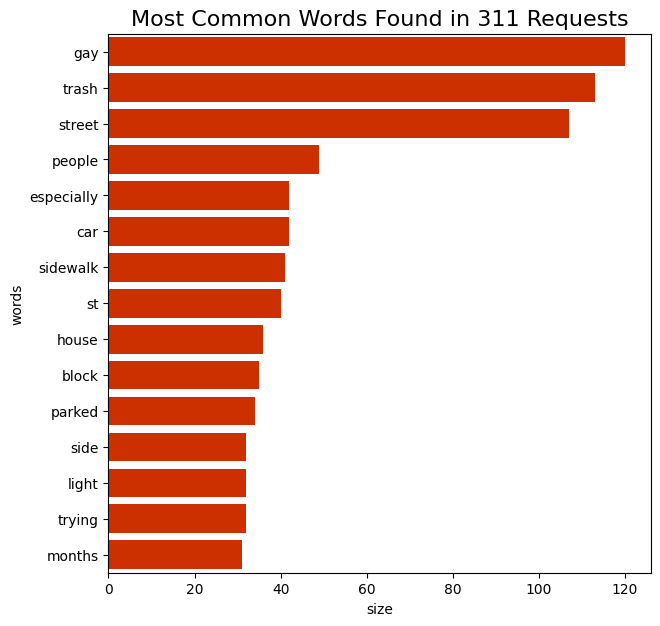

In [81]:
fig, ax = plt.subplots(figsize=(7, 7))

# Plot horizontal bar graph
sns.barplot(
    y="words",
    x="size",
    data=top15,
    ax=ax,
    color="#cc3000",
    saturation=1.0,
)

ax.set_title("Most Common Words Found in 311 Requests", fontsize=16);

**Takeaway:** Philly cares about trash! They don't call it Filthadelphia for nothing...

# PART 2 - NLP!!!
- Natural language processing via Philly's 311 API
    - Sentiment analysis
- Pulling census data and shape files via the Census API

In [82]:
# Data analysis
import geopandas as gpd
import numpy as np
import pandas as pd

# APIs
import requests

# Plotting
import seaborn as sns
from matplotlib import pyplot as plt
import holoviews as hv
import hvplot.pandas

In [83]:
N = words.groupby("words", as_index=False).size().sort_values("size", ascending=False, ignore_index=True)

**The goal**

Determine the "sentiment" of every word in the English language

*The hard way*

Train a machine learning algorithm to classify words as positive vs. negative, given an input training sample of words.

*The easy way*

Luckily, this is a **very common** task in NLP and there are several packages available that have done the hard work for you. 

They provide out-of-the-box sentiment analysis using pre-trained machine learning algorithms.

#### The `textblob` package

First, let's try out a package called `textblob`. Textblob can calculate the "polarity" of words, from negative -1 to postive +1. 

It's algorithm is not particularly sophisticated (as we will see). It was trained on IMDB movie reviews and uses a dictionary mapping of adjectives to sentiment values. So, it knows about a set of adjectives and an approximate *polarity* for those words. 

Let's try it out on the words from the 311 requests

In [84]:
import textblob

First, copy our "words" dataframe and drop any duplicate words. We'll try to calculate the sentiment for each word.

In [85]:
sentiment = words.copy().drop_duplicates(subset=['words'])

In [86]:
sentiment.head()

,words
0,sofas
1,dumped
2,family
3,dollar
4,parking


Now, create our "text blob" objects:

In [87]:
blobs = [textblob.TextBlob(word) for word in sentiment['words']]

Now use the ".polarity" attribute to calculate the sentiment:

In [88]:
sentiment["polarity"] = [blob.polarity for blob in blobs]

In [89]:
sentiment.head(10)

,words,polarity
0,sofas,0.0
1,dumped,0.0
2,family,0.0
3,dollar,0.0
4,parking,0.0
5,lot,0.0
6,city,0.0
7,owned,0.0
8,land,0.0
9,dirtiest,0.0


Most of these words are zero!

In [90]:
(sentiment['polarity'] == 0).sum()

1728

In [91]:
len(sentiment)

1906

Why did this happen?

Because the universe of words that TextBlob knows about is pretty small! Mostly confined to common adjectives/adverbs that appeared in its IMDB review dataset.

Let's take a look at the words with nonzero polarity:

In [92]:
sentiment_nonzero = sentiment.query("polarity != 0")

What are the top 15 most positive words?

In [93]:
sentiment_nonzero.sort_values("polarity", ascending=False, ignore_index=True).head(15)

,words,polarity
0,beautiful,0.85
1,great,0.80
2,fly,0.80
3,bright,0.70
4,fairly,0.70
5,good,0.70
6,apt,0.60
7,hazardous,0.60
8,kindly,0.60
9,mostly,0.50


What are the top 15 most negative words?

In [94]:
sentiment_nonzero.sort_values("polarity", ascending=True, ignore_index=True).head(15)

,words,polarity
0,terrifying,-1.000000
1,disgusting,-1.000000
2,terrible,-1.000000
3,idiots,-0.800000
4,filthy,-0.800000
5,annoying,-0.800000
6,tragic,-0.750000
7,frustrated,-0.700000
8,badly,-0.700000
9,bad,-0.700000


What about a histogram of the sentiment?

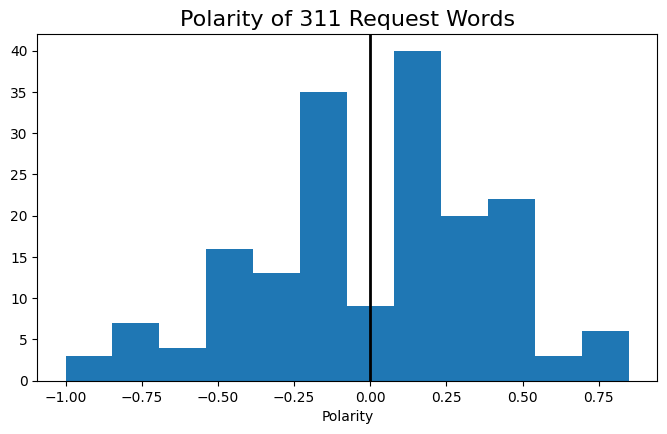

In [95]:
# create a figure and axes
fig, ax = plt.subplots(figsize=(8, 4.5))

# histogram
ax.hist(sentiment_nonzero["polarity"], bins="auto")
ax.axvline(x=0, c="k", lw=2)

# format
ax.set_xlabel("Polarity")
ax.set_title("Polarity of 311 Request Words", fontsize=16);

Hmm...this is surprising! There are many more positive words than I would have guessed!

**What could be going on?**


Most of the 311 requests are in fact *very* negative. They are mostly complaints, after all.

In the previous analysis, TextBlob only knows the sentiment for a *small* subset of the words. This is makes it difficult to produce a comprehensive sentiment for the entirety of the text for each 311 request. This is difficult because context really matters! Let's see an example:

As you can see in the below example, the negation is not picked up by the algorithm: 

In [96]:
textblob.TextBlob("Philly 311 is the best").polarity

1.0

In [97]:
textblob.TextBlob("Philly 311 is NOT the best").polarity

1.0

Both are marked as positive! (because of the word "best")

Can we do better? YES!

#### The `transformers` package

The Hugging Face `transformers` package ([documentation](https://huggingface.co/docs/transformers/index)) provides access to state-of-the-art, pre-trained machine learning algorithms for natural language processing. 

It provides access to more sophisticated machine learning models that are capable of measuring the sentiment of a piece of text using the full context of the words.



We can use the transformers `pipeline()` function to load and run our pre-trained models

In [98]:
from transformers import pipeline

#### Positive/Negative sentiment analysis

We'll start with a version of the [DistilBERT](https://huggingface.co/distilbert-base-uncased-finetuned-sst-2-english) model that has been fine-tuned on the [Stanford Sentiment Treebank](https://huggingface.co/datasets/sst2) dataset.

For an input series of text, this model will predict the POSITIVE / NEGATIVE labels with associated confidence scores. It will tell us how likely it thinks the text is positive or negative.

::: {.callout-tip}
For more info on sentiment analysis with the `transformers` package, check out this [tutorial](https://huggingface.co/docs/transformers/tasks/sequence_classification).
:::

In [99]:
# The name of the model we are using
model = "distilbert-base-uncased-finetuned-sst-2-english"

# Initialize our sentiment analyzer
sentiment_classifier = pipeline(
    task="sentiment-analysis",  # The task we are doing
    model=model,  # The specific model name
    top_k=None,  # Predict all labels, not just top ones
    tokenizer=model,  # Tokenize inputs using model tokenizer
    truncation=True,  # Truncate text if we need to
)

/Users/delmelle/miniforge3/lib/python3.10/site-packages/huggingface_hub/file_download.py:1132: FutureWarning: `resume_download` is deprecated and will be removed in version 1.0.0. Downloads always resume when possible. If you want to force a new download, use `force_download=True`.
  warnings.warn(


Now, let's pass our original list of request descriptions to the classifier. 

::: {.callout-note}
We don't need to do any text pre-processing here! We'll just pass in the raw text, so no need to remove stop words, punctuation, etc.
:::


We're now running a much more sophisticated model, so it will take more time to execute! This will likely take 2-3 minutes to run...

In [100]:
%%time

scores = sentiment_classifier(descriptions)

CPU times: user 59.3 s, sys: 1.1 s, total: 1min
Wall time: 8.49 s


What does the response structure look like?

For each description, we get a dictionary containing the label (`POSITIVE` or `NEGATIVE`) and the associated score:

In [101]:
scores[:10]

[[{'label': 'NEGATIVE', 'score': 0.9994219541549683},
  {'label': 'POSITIVE', 'score': 0.0005780915380455554}],
 [{'label': 'NEGATIVE', 'score': 0.9674744606018066},
  {'label': 'POSITIVE', 'score': 0.03252558037638664}],
 [{'label': 'NEGATIVE', 'score': 0.9994508624076843},
  {'label': 'POSITIVE', 'score': 0.0005490969633683562}],
 [{'label': 'NEGATIVE', 'score': 0.9979323148727417},
  {'label': 'POSITIVE', 'score': 0.00206767488270998}],
 [{'label': 'NEGATIVE', 'score': 0.743030846118927},
  {'label': 'POSITIVE', 'score': 0.2569691240787506}],
 [{'label': 'NEGATIVE', 'score': 0.9982733726501465},
  {'label': 'POSITIVE', 'score': 0.0017266464419662952}],
 [{'label': 'NEGATIVE', 'score': 0.9996869564056396},
  {'label': 'POSITIVE', 'score': 0.0003131047124043107}],
 [{'label': 'NEGATIVE', 'score': 0.9962969422340393},
  {'label': 'POSITIVE', 'score': 0.0037030722014606}],
 [{'label': 'NEGATIVE', 'score': 0.9723914265632629},
  {'label': 'POSITIVE', 'score': 0.02760850451886654}],
 [{'l

Let's unpack this to a more useful format:

In [104]:
yes_no = pd.DataFrame([{d["label"]: d["score"] for d in dd} for dd in scores]).assign(
    text=descriptions
)

In [105]:
yes_no.head()

,NEGATIVE,POSITIVE,text
0,0.999422,0.000578,Sofas dumped in family Dollar parking lot
1,0.967474,0.032526,"City owned land should not be the dirtiest area of a neighborhood. Car parts, boxes, and beer cans should not be on the sidewalks for weeks on end. Please clean up the sidewalks and grounds here and then come back every week and MAINTAIN YOUR PROPERTIES!"
2,0.999451,0.000549,"Flat tires, busted-out headlines. looks unuseable, broken glass around it, lots of tickets on the windshield."
3,0.997932,0.002068,"This lot, the sidewalks around it, and the street is trashed. ALL sides. Please enforce the code and/or clean this up. Thank you"
4,0.743031,0.256969,There is more by the gate.


**Note:** The scores summed across both labels will sum up to 1. 


**Total sentiment calculation**:
We can calculate the overall score by multiplying the value for each label, e.g., (POSITIVE = +1 and NEGATIVE = -1) by the confidence score for each label. This gives an overall sentiment estimate for each piece of text:

In [106]:
yes_no["sentiment"] = (yes_no["POSITIVE"] * +1) + (yes_no["NEGATIVE"] * -1)

In [107]:
yes_no.head()

,NEGATIVE,POSITIVE,text,sentiment
0,0.999422,0.000578,Sofas dumped in family Dollar parking lot,-0.998844
1,0.967474,0.032526,"City owned land should not be the dirtiest area of a neighborhood. Car parts, boxes, and beer cans should not be on the sidewalks for weeks on end. Please clean up the sidewalks and grounds here and then come back every week and MAINTAIN YOUR PROPERTIES!",-0.934949
2,0.999451,0.000549,"Flat tires, busted-out headlines. looks unuseable, broken glass around it, lots of tickets on the windshield.",-0.998902
3,0.997932,0.002068,"This lot, the sidewalks around it, and the street is trashed. ALL sides. Please enforce the code and/or clean this up. Thank you",-0.995865
4,0.743031,0.256969,There is more by the gate.,-0.486062


**Question:** Are most of the reviews positive or negative?


Let's take a look at the mean and median:

In [110]:
yes_no['sentiment'].mean()

-0.8020071757158209

In [111]:
yes_no['sentiment'].median()

-0.9938700476195663

Ah! By far, most of these are negative!

Philadelphians using the 311 system appear to be *very* upset.

Let's take a look at the overall histogram of sentiment too:

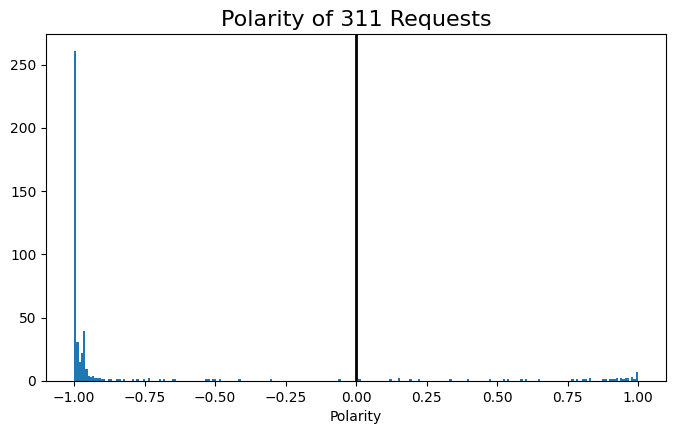

In [112]:
# Create a figure and axes
fig, ax = plt.subplots(figsize=(8, 4.5))

# Histogram
ax.hist(yes_no['sentiment'], bins="auto")
ax.axvline(x=0, c="k", lw=2)

# Format
ax.set_xlabel("Polarity")
ax.set_title("Polarity of 311 Requests", fontsize=16);

Whoa! Very negative sentiment!

**This makes much more sense than our earlier results with the Textblob package.**

Let's look at the 10 requests with the lowest sentiment scores:

In [113]:
yes_no.sort_values("sentiment", ascending=True).head(10)

,NEGATIVE,POSITIVE,text,sentiment
462,0.999790,0.000210,people park in lot and the sidewalk is gone. \nneeds a CLIP fence near sidewalk to prevent parking.,-0.999579
182,0.999788,0.000212,the street is sinking,-0.999576
459,0.999787,0.000214,"THE TRUCK HAS BEEN SITTING IN FRONT OF MY DOOR FOR OVER 6 MONTHS NOW AND IT HAS NOT MOVED. THE TIRES ARE FLAT AND SEEMS TO BE BROKEN DOWN. PLEASE COME REMOVE THIS VEHICLE, THIS IS MY 2ND REQUEST.",-0.999573
448,0.999786,0.000214,Junk suv,-0.999572
449,0.999780,0.000220,Been sitting for months and has a flat tire it’s abandoned,-0.999560
232,0.999777,0.000223,"The crosswalk here across 15th street just north of Latiner street is useless. First needs repainting, 2nd we need a speed bump/flashing lights/yield to pedestrian signs. Cars drive 30-40mph there and nearly run over pedestrians using crosswalk. Completely unsafe.",-0.999554
227,0.999777,0.000223,"The crosswalk here across 15th street just north of Latiner street is useless. First needs repainting, 2nd we need a speed bump/flashing lights/yield to pedestrian signs. Cars drive 30-40mph there and nearly run over pedestrians using crosswalk. Completely unsafe.",-0.999554
415,0.999777,0.000223,someone dumped their used flooring behind 1411 n myrtlewood st. Likely the people gutting 2933 master st.,-0.999554
48,0.999772,0.000228,Switch for crossing light on school side of street is not working. Are there red lights that can replace the yellow lights as traffic just ignores yellow lights?,-0.999543
276,0.999767,0.000233,Sign knocked over by traffic on Henry Ave. No parking and school speed limit sign.,-0.999535


And the 10 requests with the highest sentiment:

In [114]:
yes_no.sort_values("sentiment", ascending=False).head(10)

,NEGATIVE,POSITIVE,text,sentiment
149,0.000219,0.999781,Graffiti on building. Please and thank you!,0.999563
146,0.000289,0.999711,Graffiti on sign. Please and thank you!,0.999422
351,0.000541,0.999459,It's still here,0.998918
202,0.001197,0.998803,Large trees and shrubs are growing and starting to hit my home and wires,0.997606
111,0.002534,0.997466,The street light bulb was just replaced with a highly intense extremely bright LED. This light is illuminating my livingroom and bedroom making it almost impossible to sleep. The street light is directly outside of an elderly womens bedroom. The intensity of the light is also reflecting off the womens window into my house. Nothing was wrong with the original bulb. Please have the bulb replaced with the original light bulb,0.994933
279,0.002590,0.997410,"Although there is good signage out there. We have received complaints of vehicles not yielding to pedestrians in the crosswalk that goes across Powelton Ave at 32nd St. After surveying the area the last couple days in the morning and afternoon, vehicles are seen driving (particularly east) on Powelton Ave and not yielding to pedestrians standing in the crosswalk waiting to cross. \n\nCan signs be added on the poles that say, “Yield to Pedestrians in Crosswalk”? We will step up enforcement as well. Thank you!",0.994819
164,0.003370,0.996630,"An abundance of lights along the pedestrian trail are out. Between Walnut st & Chestnut St bridges, between Chestnut St & Market St bridges and between Market St & JFK. Beyond that, there are many others out along the trail all the way to the Art Museum. There are so many lights out along the trail that I cannot give an exact address.",0.993260
49,0.006432,0.993568,Red light flashing,0.987135
265,0.008530,0.991470,this is an area that you guys have painted over before. I attached a picture. this is behind out building. There is a driveway you can pull up in to paint this and the other area I submitted. \r\n\r\nthanks again!!,0.982940
67,0.009632,0.990368,Foodstuffs etc.,0.980737


**Takeaway**

The model is still clearly focusing on some crucial words (please, thank you = "positive") but overall, doing a much, much better job overall of understanding the full context of the text. 

#### Emotion sentiment analysis

The `transformers` package also includes pre-trained models that can predict *emotion* labels. 

As an example, let's try out [this version](https://huggingface.co/bhadresh-savani/distilbert-base-uncased-emotion) of the DistilBERT model that can predict the following labels for a string of text: anger, fear, sadness, joy, love, and surprise.

In [115]:
# The model
model = "bhadresh-savani/distilbert-base-uncased-emotion"

# Initialize our sentiment analyzer
emotion_classifier = pipeline(
    task="text-classification",  # The task we are doing
    model=model,  # The specific model name
    top_k=None,  # Predict all labels, not just top ones
    tokenizer=model,  # Tokenize inputs using model tokenizer
    truncation=True,  # Truncate text if we need to
)

/Users/delmelle/miniforge3/lib/python3.10/site-packages/huggingface_hub/file_download.py:1132: FutureWarning: `resume_download` is deprecated and will be removed in version 1.0.0. Downloads always resume when possible. If you want to force a new download, use `force_download=True`.
  warnings.warn(


model.safetensors:   0%|          | 0.00/268M [00:00<?, ?B/s]

Classify the 311 descriptions using our emotions model. Once again, this will likely take 2-3 minutes to run:

In [117]:
%%time 

emotion_scores = emotion_classifier(descriptions)

CPU times: user 56.2 s, sys: 712 ms, total: 56.9 s
Wall time: 7.15 s


In [118]:
emotion_scores[0]

[{'label': 'anger', 'score': 0.8814123868942261},
 {'label': 'fear', 'score': 0.059103988111019135},
 {'label': 'sadness', 'score': 0.05452335253357887},
 {'label': 'joy', 'score': 0.0025181674864143133},
 {'label': 'surprise', 'score': 0.0016718643018975854},
 {'label': 'love', 'score': 0.0007701974827796221}]

Unpack the label/score combos into a DataFrame:

In [119]:
emotion = pd.DataFrame(
    [{d["label"]: d["score"] for d in dd} for dd in emotion_scores]
).assign(text=descriptions)

In [135]:
emotion.head()

,fear,anger,joy,sadness,surprise,love,text
0,0.669527,0.197261,0.094020,0.019364,0.012044,0.007784,On the southwest corner of the intersection of S. 46th Street and Woodland Avenue.
1,0.859705,0.120488,0.010728,0.003260,0.004663,0.001155,On the 'No Dumping' street sign on the south side of Cedar Avenue about 11 steps west of S. 46th Street. Next to the tiny park.
2,0.000414,0.002554,0.989055,0.001997,0.000243,0.005738,Apartment complex is dumping trash on our street again! Please help or tell me the proper channels I need to take. Thank you!
3,0.184317,0.698201,0.062046,0.050890,0.002694,0.001853,People speed up the street like they’re all 95 it needs to have street cushions put in or speed bumps whatever you wanna call
4,0.740593,0.133473,0.011053,0.108852,0.004859,0.001170,This vehicle has been parked on the 5300 block of Sycamore Street. The car appears to be stolen and parts from the vehicle were removed such as Steering wheel – and other items


Now, let's calculate the predicted label for each text. This is the label with the highest score for each text.

In [120]:
emotion_labels = ["anger", "fear", "sadness", "joy", "surprise", "love"]

Use the `idxmax()` function to find the column with the maximum value for each row:

In [121]:
emotion[emotion_labels].idxmax(axis=1)

0        anger
1        anger
2      sadness
3      sadness
4        anger
        ...   
458       fear
459    sadness
460    sadness
461       fear
462      anger
Length: 463, dtype: object

In [122]:
emotion['prediction'] = emotion[emotion_labels].idxmax(axis=1)

In [123]:
emotion.head()

,anger,fear,sadness,joy,surprise,love,text,prediction
0,0.881412,0.059104,0.054523,0.002518,0.001672,0.000770,Sofas dumped in family Dollar parking lot,anger
1,0.849176,0.008947,0.101247,0.037895,0.000838,0.001897,"City owned land should not be the dirtiest area of a neighborhood. Car parts, boxes, and beer cans should not be on the sidewalks for weeks on end. Please clean up the sidewalks and grounds here and then come back every week and MAINTAIN YOUR PROPERTIES!",anger
2,0.000933,0.003935,0.993833,0.000665,0.000448,0.000185,"Flat tires, busted-out headlines. looks unuseable, broken glass around it, lots of tickets on the windshield.",sadness
3,0.072639,0.001041,0.915300,0.008955,0.000860,0.001205,"This lot, the sidewalks around it, and the street is trashed. ALL sides. Please enforce the code and/or clean this up. Thank you",sadness
4,0.581607,0.194308,0.022950,0.191365,0.004418,0.005351,There is more by the gate.,anger


What's the breakdown across the predicted labels?

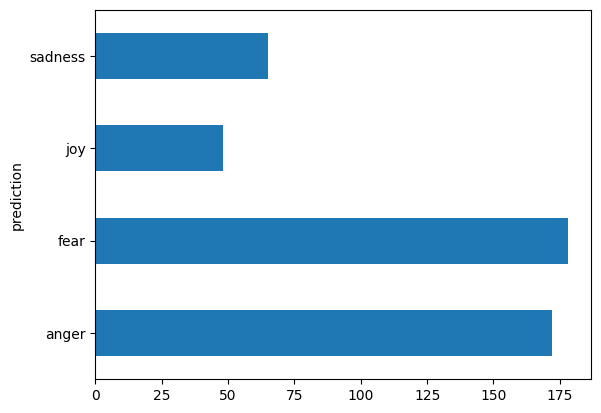

In [124]:
emotion.groupby("prediction").size().plot(kind='barh');

**Takeaway:**  Most descriptions are classified as "fear" or "anger"

How about visualizing the full distribution of scores across all emotions?

Let's get a tidy version for analysis:

In [125]:
emotion_tidy = emotion.melt(
    id_vars=["text"], value_vars=emotion_labels, var_name="emotion", value_name="score"
)

In [126]:
emotion_tidy.head()

,text,emotion,score
0,Sofas dumped in family Dollar parking lot,anger,0.881412
1,"City owned land should not be the dirtiest area of a neighborhood. Car parts, boxes, and beer cans should not be on the sidewalks for weeks on end. Please clean up the sidewalks and grounds here and then come back every week and MAINTAIN YOUR PROPERTIES!",anger,0.849176
2,"Flat tires, busted-out headlines. looks unuseable, broken glass around it, lots of tickets on the windshield.",anger,0.000933
3,"This lot, the sidewalks around it, and the street is trashed. ALL sides. Please enforce the code and/or clean this up. Thank you",anger,0.072639
4,There is more by the gate.,anger,0.581607


Make a box plot of the distribution across all emotions:

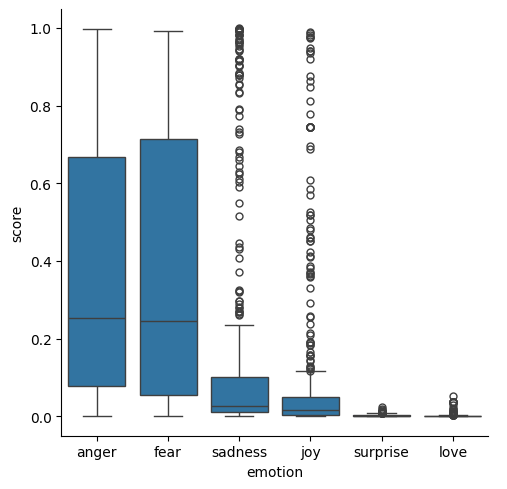

In [127]:
sns.catplot(data=emotion_tidy, x="emotion", y="score", kind="box");

**Takeaway:**

Fear and anger! For emotions other than anger/fear, confidence scores are concentrated near zero, indicating that the text likely does not contain those emotions.

Let's do a deeper dive on some of the emotions:

**Anger**

In [128]:
angry_requests = emotion.query("anger > 0.8").sort_values("anger", ascending=False)

In [129]:
len(angry_requests)

78

In [130]:
angry_requests.head(20)

,anger,fear,sadness,joy,surprise,love,text,prediction
92,0.996994,0.000990,0.001476,0.000276,0.000129,0.000136,"Every single week people in the neighborhood and sometimes even people outside of the neighborhood leave litter, bagged trash, and even car parts outside of my grey building at 966 granite st. They seem to always put it next to the wooden light pole near the alley . At one point I even submitted a complaint that included the persons address and name since they foolishly left trash that had mailing labels on it . I’m getting very frustrated with this filthy inconsiderate people .",anger
312,0.996456,0.002156,0.000497,0.000443,0.000158,0.000290,the entire block of 1900 N. American Street lights off. Dangerous at night for pedestrian. please take care of this matter asap,anger
41,0.996401,0.002041,0.000418,0.000505,0.000237,0.000398,Dangerous!,anger
359,0.995655,0.002437,0.000902,0.000596,0.000175,0.000235,Cars drive extremely fast down street and the corner of Weikel and Clearfield is a dangerous corner and there have been several accidents .,anger
192,0.995275,0.003162,0.000659,0.000550,0.000168,0.000187,Work team showed up today to install windows in a building with a stop work dangerous building notice on the front door.,anger
162,0.995243,0.002330,0.001114,0.000887,0.000213,0.000212,Someone has climbed telephone polls along Green Lane in Manayunk and fixed Trump songs very high up. It’s distracting and should not be allowed. \r\n\r\nThere are multiple signs on multiple poles.,anger
34,0.994317,0.003598,0.001067,0.000669,0.000153,0.000196,There is a big hole in the middle of street very dangerous. currently a temporary cover/fence was put on it. please come and fix it. somebody came and put a sign 3 months ago and nobody came back to fix it,anger
333,0.993974,0.004460,0.000617,0.000546,0.000175,0.000229,There is a very dangerous tree with branches on wires that could fall down at any minute.,anger
372,0.992994,0.000841,0.004126,0.000671,0.000511,0.000856,This giant set of new buildings was built over the last year and a half and opened and sold in the last few months. They never cleaned up after their giant construction project. It’s still disgusting and all of the owners aren’t interested in cleaning it up. I’ve reported this before it’s more than just 1801 S. Oriana.,anger
434,0.990447,0.007542,0.000952,0.000603,0.000202,0.000254,Large box truck has been in the same spots for weeks. Hard to see around it making parking dangerous. \r\n3850 Woodhaven Road,anger


**Fear**

And the most fearful:

In [131]:
fearful_requests = emotion.query("fear > 0.8").sort_values("fear", ascending=False)

In [132]:
len(fearful_requests)

55

In [133]:
fearful_requests.head(20)

,anger,fear,sadness,joy,surprise,love,text,prediction
458,0.004531,0.991316,0.002178,0.001203,0.000531,0.000241,"Three Caucasian folks were hanging around the area amongst scattered cardboard boxes, clothes, blankets, etc. This area under the Vine St Expy is susceptible to loitering and small encampments and should be monitored regularly, if possible.",fear
378,0.006096,0.989046,0.002773,0.000990,0.000878,0.000217,"Flat tires, very dirty, has not been moved for 4-5 months. Owner is unknown; neither a resident of the block or a neighbor living close by.",fear
303,0.006691,0.987627,0.003426,0.001267,0.000766,0.000223,Car left crashed into a tree. Possibly stolen. In Fisher park against a tree and partially in the roadway. Potential traffic obstruction and danger. Please have it removed.,fear
411,0.006805,0.977448,0.011772,0.001656,0.001972,0.000347,Car was in an accident,fear
115,0.017777,0.973921,0.004710,0.002192,0.001031,0.000371,"There are many trees below the street light , which is out. The pathway under the trees is very dark.",fear
129,0.020954,0.963613,0.010324,0.002380,0.002246,0.000483,Vehicle stolen and dumped inside Tacony creek park Whitaker gateway entrance.,fear
122,0.015536,0.960532,0.018397,0.003459,0.001661,0.000414,It has been stationary over a month with expired inspection and flat tire.,fear
318,0.029563,0.960280,0.002320,0.004132,0.002882,0.000823,On the southeast corner of the intersection of S. 47th Street and Woodland Avenue. On the back of the small metal sign holding the crosswalk button.,fear
117,0.037367,0.956178,0.003575,0.001493,0.001055,0.000332,car has not moved in 3 days per the Philadelphia parking authority rules. leaking motor oil in street,fear
382,0.037929,0.956143,0.002936,0.001672,0.000994,0.000325,improper container was left by someone else nearby not sure who. this usually happens at midnight.. People also litter on the sidewalk.,fear


**Takeaway:**

Overall, the algorithm is doing a pretty good job picking up the emotion and sentiment in the requests. 

One potential use case for a model like this: *prioritizing responses*. For example:

- You might want to respond more quickly to those that are classified as the most fearful, given that those situations might be the most dangerous. 
- Or, requests that are classified as the angriest might warrant a closer follow-up from a city representative, since many of these requests are likely repeated requests from frustrated residents.

But, once again, we see the limitations of sentiment analysis as text with words like "thank you" and "please" get classified as positive ("joy"):

In [134]:
joyful_requests = emotion.query("joy > 0.8").sort_values("joy", ascending=False)

Not that many requests!

In [135]:
len(joyful_requests)

15

In [136]:
joyful_requests.head(20)

,anger,fear,sadness,joy,surprise,love,text,prediction
146,0.003696,0.000729,0.001794,0.988631,0.000529,0.004622,Graffiti on sign. Please and thank you!,joy
30,0.005533,0.001772,0.003188,0.988004,0.000351,0.001152,"I have summitted several about this. I continue to receive notification's that it is resolved, but it has not. Last e mail I received. 17217651",joy
271,0.011084,0.001339,0.004564,0.980372,0.000859,0.001782,5x10 foot wall that sticks out from building. You have already painted over (black) they added graffiti again. Thanks for your help!,joy
427,0.013238,0.004104,0.003660,0.977238,0.000532,0.001229,"Hi- this is the second time in a row trash is collected in our street but they do not come t ours, which is in an accessible proper black trash can. How do I ensure this doesn’t happen again? What should I do until they pick it up?",joy
149,0.011952,0.001432,0.003433,0.976533,0.000805,0.005845,Graffiti on building. Please and thank you!,joy
26,0.013683,0.002621,0.007755,0.973872,0.000624,0.001445,"Per request 17220036 I reported that recycling had not been collected on N 19th street between Spring Garden and Green Streets. I received notice that the request was ""resolved."" The recycling has not been collected so it is not ""resolved."" Thanks",joy
243,0.033909,0.006310,0.005496,0.948654,0.001171,0.004460,"Hi! I am trying to throw out an old hot tub cover. I actually have two points where I can put my trash out--at the end of my common driveway behind the house and entered into off of Brown Street on Fridays or in front of my house (790 N 25th Street) on Wed.\r\n\r\nThe cover is not heavy, but a bit bulky. I cut it in half at the fold in order to make it easier.\r\n\r\nI put the cover pieces out last Sat. morning on Brown St (there was a holiday), but it was not taken. I put the cover out last night for pick up in front of my house this morning (Wed.), but it again was not taken (the other trash there was).\r\n\r\nI was wondering 1) if the cover parts should be being picked up or 2) if this is something I should schedule a bulk pick-up for (it doesn't easily fit into the provided categories, so I'm not sure if it is eligible).\r\n\r\nI appreciate your help in my sorting out this matter!\r\n\r\nBlaine\r\n\r\n(You can also reach me by text at the number I provided, or email me at 267-975-6704)",joy
68,0.020574,0.001618,0.031339,0.940549,0.000785,0.005135,Sewer needs to be cleaned. Thank you.,joy
69,0.020574,0.001618,0.031339,0.940549,0.000785,0.005135,Sewer needs to be cleaned. Thank you.,joy
226,0.046364,0.009177,0.006296,0.934953,0.001868,0.001342,Tons of trash piled up and has been for days. Consistent problem here.,joy


*Sentiment analysis* -- a helpful, but imperfect analysis tool!

# PART 3: The Census API

### US Census data is foundational

- Rich data sets with annual releases
- Decennial results plus American Community Survey (ACS) results
- Wide range of topics covered: sex, income, poverty, education, housing

### Getting census data (the new way)<br>census.data.gov

<center>
    <a href=https://data.census.gov/><img src="imgs/census-2.png" width=500></img></a>
</center>

### Example: poverty data
<center>
    <a href="https://data.census.gov/table/ACSST1Y2021.S1701?q=poverty+status&g=010XX00US$0400000&tid=ACSST1Y2021.S1701"><img src="imgs/poverty-1.png" width=600></img></a>
</center>

#### Via the API

**RUN** --> [https://api.census.gov/data/2021/acs/acs1?get=NAME,B17001_002E&for=state:*](https://api.census.gov/data/2021/acs/acs1?get=NAME,B17001_002E&for=state:*)

- **Base endpoint:** https://api.census.gov/data/2021/acs/acs1
- **Request parameters:** "get", "for"

<center>
    <img src="imgs/poverty-2.png" width=300></img></a>
</center>

### How to find the right variable names?

The census provides web-based documentation:

- Overview of all data tables: [https://api.census.gov/data.html](https://api.census.gov/data.html)
- All data tables for 2021: [https://api.census.gov/data/2021.html](https://api.census.gov/data/2021.html)
- All variables for 2021 ACS 5-year data set: [https://api.census.gov/data/2021/acs/acs5/variables.html](https://api.census.gov/data/2021/acs/acs5/variables.html)

### A detailed Census API guide

[https://www.census.gov/data/developers/guidance/api-user-guide.html](https://www.census.gov/data/developers/guidance/api-user-guide.html)

### Accessing the API is easier from Python

Several packages provide easier Python interfaces to census data based on the census API.

We'll focus on **`cenpy` - "Explore and download data from Census APIs"**
 - [Documentation](https://cenpy-devs.github.io/cenpy/)
 - [GitHub](https://github.com/cenpy-devs/cenpy)

### Example: the racial "dot" map

![](imgs/racial-dot-map.png)

Source: [Washington Post](https://www.washingtonpost.com/graphics/2018/national/segregation-us-cities/)

Let's make this for Philadelphia in Python!

In [4]:
# First step: import cenpy
#!pip install cenpy
import cenpy

/Users/delmelle/miniforge3/lib/python3.10/site-packages/fuzzywuzzy/fuzz.py:11: UserWarning: Using slow pure-python SequenceMatcher. Install python-Levenshtein to remove this warning
  warnings.warn('Using slow pure-python SequenceMatcher. Install python-Levenshtein to remove this warning')


#### The "explorer" module

Functions to help you explore the Census API from Python

- [`cenpy.explorer.available`](https://cenpy-devs.github.io/cenpy/generated/cenpy.explorer.available.html#cenpy.explorer.available): Returns information about available datasets in Census API
- [`cenpy.explorer.explain`](https://cenpy-devs.github.io/cenpy/generated/cenpy.explorer.explain.html#cenpy.explorer.explain): Explain a specific Census dataset
- [`cenpy.explorer.fips_table`](https://cenpy-devs.github.io/cenpy/generated/cenpy.explorer.fips_table.html#cenpy.explorer.fips_table): Get a table of FIPS codes for a specific geography

**Note: we can change pandas display options to see all rows/columns and large cells**

In [154]:
# UNCOMMENT TO SEE ALL ROWS/COLUMNS IN DATAFRAMES
# pd.options.display.max_rows = 9999 
# pd.options.display.max_colwidth = 200

#### Step 1: Identify what dataset we want

- Today, we'll use the 5-year American Community Survey (latest available year: 2021)
- Other common datasets: 
    - 1-year ACS datasets as well (latest available year: 2022)
    - 10-year decennial survey (latest available year: 2020)

In [120]:
available = cenpy.explorer.available()

available.head()

/Users/delmelle/miniforge3/lib/python3.10/site-packages/cenpy/explorer.py:70: FutureWarning: DataFrame.applymap has been deprecated. Use DataFrame.map instead.
  listcols = raw_table.applymap(lambda x: isinstance(x, list)).any()


,c_isMicrodata,c_isTimeseries,publisher,temporal,spatial,programCode,modified,keyword,contactPoint,distribution,description,bureauCode,accessLevel,title,c_isAvailable,c_isCube,c_isAggregate,c_dataset,vintage
ABSCB2017,NaN,NaN,U.S. Census Bureau,2017/2017,United States,006:007,2020-04-30 00:00:00.0,"(census,)","{'fn': 'ABS Staff', 'hasEmail': 'mailto:adep.a...","{'@type': 'dcat:Distribution', 'accessURL': 'h...",The Annual Business Survey (ABS) provides info...,006:07,public,Annual Business Survey: Characteristics of Bus...,True,NaN,True,"(abscb,)",2017.0
ABSCB2018,NaN,NaN,U.S. Census Bureau,2018/2018,United States,006:007,2020-10-26 00:00:00.0,"(census,)","{'fn': 'ABS Staff', 'hasEmail': 'mailto:adep.a...","{'@type': 'dcat:Distribution', 'accessURL': 'h...",The Annual Business Survey (ABS) provides info...,006:07,public,Annual Business Survey: Characteristics of Bus...,True,NaN,True,"(abscb,)",2018.0
ABSCB2019,NaN,NaN,U.S. Census Bureau,2019/2019,US,006:007,2021-08-17 00:00:00.0,"(census,)","{'fn': 'ASE Staff', 'hasEmail': 'mailto:ERD.an...","{'@type': 'dcat:Distribution', 'accessURL': 'h...",The Annual Business Survey (ABS) provides info...,006:07,public,2019 Annual Business Survey: Characteristics o...,True,NaN,True,"(abscb,)",2019.0
ABSCB2020,NaN,NaN,U.S. Census Bureau,2020/2020,US,006:007,2022-08-03 00:00:00.0,"(census,)","{'fn': 'ASE Staff', 'hasEmail': 'mailto:ERD.an...","{'@type': 'dcat:Distribution', 'accessURL': 'h...",The Annual Business Survey (ABS) provides info...,006:07,public,2020 Annual Business Survey: Characteristics o...,True,NaN,True,"(abscb,)",2020.0
ABSCB2021,NaN,NaN,U.S. Census Bureau,2021/2021,United States,006:007,2023-07-24 10:30:52.0,"(census,)","{'fn': 'ABS Staff', 'hasEmail': 'mailto:adep.a...","{'@type': 'dcat:Distribution', 'accessURL': 'h...",The Annual Business Survey (ABS) provides info...,006:07,public,2021 Annual Business Survey: Characteristics o...,True,NaN,True,"(abscb,)",2021.0


We can use the pandas [`filter()`](https://pandas.pydata.org/pandas-docs/stable/reference/api/pandas.DataFrame.filter.html) to search for specific identifiers in the dataframe. 

In this case, let's search for the American Community Survey datasets. We'll match index labels using *regular expressions*. 

In particular, we'll search for labels that start with "ACS". In the language of regular expressions, we'll use the "^" to mean "match labels that start with"

For more info on regular expressions, the [documentation for the re module](https://docs.python.org/3/library/re.html) is a good place to start.

In [121]:
# Return a dataframe of all datasets that start with "ACS"
# Axis=0 means to filter the index labels!
acs = available.filter(regex="^ACS", axis=0)

acs

,c_isMicrodata,c_isTimeseries,publisher,temporal,spatial,programCode,modified,keyword,contactPoint,distribution,description,bureauCode,accessLevel,title,c_isAvailable,c_isCube,c_isAggregate,c_dataset,vintage
ACSCD1132011,NaN,NaN,U.S. Census Bureau,2011/2011,United States,006:004,2014-10-06,"(census,)","{'fn': 'American Community Survey Office', 'ha...","{'@type': 'dcat:Distribution', 'accessURL': 'h...",The American Community Survey (ACS) is a natio...,006:07,public,2011 American Community Survey 1-Year Profiles...,True,NaN,True,"(acs1, cd113)",2011.0
ACSCD1152015,NaN,NaN,U.S. Census Bureau,2015/2015,United States,006:004,2017-02-10,"(census,)","{'fn': 'American Community Survey Office', 'ha...","{'@type': 'dcat:Distribution', 'accessURL': 'h...",The American Community Survey (ACS) is an ongo...,006:07,public,2015 American Community Survey 1-Year Data Pro...,True,NaN,True,"(acs1, cd115)",2015.0
ACSCP1Y2010,NaN,NaN,U.S. Census Bureau,NaN,United States,006:004,2018-09-18 00:00:00.0,"(census,)","{'fn': 'American Community Survey Office', 'ha...","{'@type': 'dcat:Distribution', 'accessURL': 'h...",The American Community Survey (ACS) is an ongo...,006:07,public,ACS 1-Year Comparison Profiles,True,True,True,"(acs, acs1, cprofile)",2010.0
ACSCP1Y2011,NaN,NaN,U.S. Census Bureau,NaN,United States,006:004,2018-09-18 00:00:00.0,"(census,)","{'fn': 'American Community Survey Office', 'ha...","{'@type': 'dcat:Distribution', 'accessURL': 'h...",The American Community Survey (ACS) is an ongo...,006:07,public,ACS 1-Year Comparison Profiles,True,True,True,"(acs, acs1, cprofile)",2011.0
ACSCP1Y2012,NaN,NaN,U.S. Census Bureau,NaN,NaN,006:004,2018-07-05 00:00:00.0,"(census,)","{'fn': 'American Community Survey Office', 'ha...","{'@type': 'dcat:Distribution', 'accessURL': 'h...",The American Community Survey (ACS) is an ongo...,006:07,public,ACS 1-Year Comparison Profiles,True,True,True,"(acs, acs1, cprofile)",2012.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
ACSST5Y2018,NaN,NaN,U.S. Census Bureau,NaN,NaN,006:004,2019-10-22 15:36:29.0,"(census,)","{'fn': 'American Community Survey Office', 'ha...","{'@type': 'dcat:Distribution', 'accessURL': 'h...",The American Community Survey (ACS) is an ongo...,006:07,public,ACS 5-Year Subject Tables,True,True,True,"(acs, acs5, subject)",2018.0
ACSST5Y2019,NaN,NaN,U.S. Census Bureau,NaN,NaN,006:004,2020-04-03 00:00:00.0,"(census,)","{'fn': 'American Community Survey Office', 'ha...","{'@type': 'dcat:Distribution', 'accessURL': 'h...",The American Community Survey (ACS) is an ongo...,006:07,public,American Community Survey: 5-Year Estimates: S...,True,True,True,"(acs, acs5, subject)",2019.0
ACSST5Y2020,NaN,NaN,U.S. Census Bureau,2020/2020,US,006:004,2021-07-13 00:00:00.0,"(census,)","{'fn': 'American Community Survey Office', 'ha...","{'@type': 'dcat:Distribution', 'accessURL': 'h...",The American Community Survey (ACS) is an ongo...,006:07,public,American Community Survey: 5-Year Estimates: S...,True,True,True,"(acs, acs5, subject)",2020.0
ACSST5Y2021,NaN,NaN,U.S. Census Bureau,2021/2021,US,006:004,2022-08-08 00:00:00.0,"(census,)","{'fn': 'American Community Survey Office', 'ha...","{'@type': 'dcat:Distribution', 'accessURL': 'h...",The American Community Survey (ACS) is an ongo...,006:07,public,American Community Survey: 5-Year Estimates: S...,True,True,True,"(acs, acs5, subject)",2021.0


Many flavors of ACS datasets are available — we want to use the *detailed tables* version, specifically the 5-year survey. 

The relevant identifiers start with: "ACSDT5Y".

In [122]:
# Return a dataframe of all datasets that start with "ACSDT5Y"
available.filter(regex="^ACSDT5Y", axis=0)

,c_isMicrodata,c_isTimeseries,publisher,temporal,spatial,programCode,modified,keyword,contactPoint,distribution,description,bureauCode,accessLevel,title,c_isAvailable,c_isCube,c_isAggregate,c_dataset,vintage
ACSDT5Y2009,NaN,NaN,U.S. Census Bureau,NaN,NaN,006:004,2019-08-27 13:11:18.0,"(census,)","{'fn': 'American Community Survey Office', 'ha...","{'@type': 'dcat:Distribution', 'accessURL': 'h...",The American Community Survey (ACS) is an ongo...,006:07,public,American Community Survey: 5-Year Estimates: D...,True,True,True,"(acs, acs5)",2009.0
ACSDT5Y2010,NaN,NaN,U.S. Census Bureau,NaN,United States,006:004,2018-07-04 00:00:00.0,"(census,)","{'fn': 'American Community Survey Office', 'ha...","{'@type': 'dcat:Distribution', 'accessURL': 'h...",The American Community Survey (ACS) is an ongo...,006:07,public,ACS 5-Year Detailed Tables,True,True,True,"(acs, acs5)",2010.0
ACSDT5Y2011,NaN,NaN,U.S. Census Bureau,NaN,NaN,006:004,2018-07-04 00:00:00.0,"(census,)","{'fn': 'American Community Survey Office', 'ha...","{'@type': 'dcat:Distribution', 'accessURL': 'h...",The American Community Survey (ACS) is an ongo...,006:07,public,ACS 5-Year Detailed Tables,True,True,True,"(acs, acs5)",2011.0
ACSDT5Y2012,NaN,NaN,U.S. Census Bureau,NaN,NaN,006:004,2018-07-04 00:00:00.0,"(census,)","{'fn': 'American Community Survey Office', 'ha...","{'@type': 'dcat:Distribution', 'accessURL': 'h...",The American Community Survey (ACS) is an ongo...,006:07,public,ACS 5-Year Detailed Tables,True,True,True,"(acs, acs5)",2012.0
ACSDT5Y2013,NaN,NaN,U.S. Census Bureau,NaN,NaN,006:004,2018-07-04 00:00:00.0,"(census,)","{'fn': 'American Community Survey Office', 'ha...","{'@type': 'dcat:Distribution', 'accessURL': 'h...",The American Community Survey (ACS) is an ongo...,006:07,public,ACS 5-Year Detailed Tables,True,True,True,"(acs, acs5)",2013.0
ACSDT5Y2014,NaN,NaN,U.S. Census Bureau,NaN,NaN,006:004,2018-07-04 00:00:00.0,"(census,)","{'fn': 'American Community Survey Office', 'ha...","{'@type': 'dcat:Distribution', 'accessURL': 'h...",The American Community Survey (ACS) is an ongo...,006:07,public,ACS 5-Year Detailed Tables,True,True,True,"(acs, acs5)",2014.0
ACSDT5Y2015,NaN,NaN,U.S. Census Bureau,NaN,NaN,006:004,2018-07-05 00:00:00.0,"(census,)","{'fn': 'American Community Survey Office', 'ha...","{'@type': 'dcat:Distribution', 'accessURL': 'h...",The American Community Survey (ACS) is an ongo...,006:07,public,ACS 5-Year Detailed Tables,True,True,True,"(acs, acs5)",2015.0
ACSDT5Y2016,NaN,NaN,U.S. Census Bureau,NaN,NaN,006:004,2018-07-05 00:00:00.0,"(census,)","{'fn': 'American Community Survey Office', 'ha...","{'@type': 'dcat:Distribution', 'accessURL': 'h...",The American Community Survey (ACS) is an ongo...,006:07,public,ACS 5-Year Detailed Tables,True,True,True,"(acs, acs5)",2016.0
ACSDT5Y2017,NaN,NaN,U.S. Census Bureau,NaN,NaN,006:004,2018-08-21 07:11:43.0,"(census,)","{'fn': 'American Community Survey Office', 'ha...","{'@type': 'dcat:Distribution', 'accessURL': 'h...",The American Community Survey (ACS) is an ongo...,006:07,public,ACS 5-Year Detailed Tables,True,True,True,"(acs, acs5)",2017.0
ACSDT5Y2018,NaN,NaN,U.S. Census Bureau,NaN,NaN,006:004,2019-10-22 16:28:02.0,"(census,)","{'fn': 'American Community Survey Office', 'ha...","{'@type': 'dcat:Distribution', 'accessURL': 'h...",The American Community Survey (ACS) is an ongo...,006:07,public,American Community Survey: 5-Year Estimates: D...,True,True,True,"(acs, acs5)",2018.0


Let's use the latest available 5-year data (2021). We can use the `explain()` function to print out a description of the dataset:

In [123]:
cenpy.explorer.explain("ACSDT5Y2021")

{'American Community Survey: 5-Year Estimates: Detailed Tables 5-Year': 'The American Community Survey (ACS) is an ongoing survey that provides data every year -- giving communities the current information they need to plan investments and services. The ACS covers a broad range of topics about social, economic, demographic, and housing characteristics of the U.S. population. Summary files include the following geographies: nation, all states (including DC and Puerto Rico), all metropolitan areas, all congressional districts, all counties, all places, and all tracts and block groups. Summary files contain the most detailed cross-tabulations, many of which are published down to block groups. The data are population and housing counts. There are over 64,000 variables in this dataset.'}

#### Step 2: Initialize the API connection

Use the `cenpy.remote.APIConnection` object, and pass it the name of the dataset.

In [124]:
acs = cenpy.remote.APIConnection("ACSDT5Y2021")

#### Step 3: Find the variables we want to load

The `.variables` attribute stores the available variables (across all Census tables). 

We can use the `varslike()` function to search the `variables` dataframe (it's just a simple wrapper around the pandas `filter()` function).

In [125]:
len(acs.variables)

27927

In [126]:
acs.variables.head(n=10)

,label,concept,predicateType,group,limit,predicateOnly,hasGeoCollectionSupport,attributes,required
for,Census API FIPS 'for' clause,Census API Geography Specification,fips-for,N/A,0,True,NaN,NaN,NaN
in,Census API FIPS 'in' clause,Census API Geography Specification,fips-in,N/A,0,True,NaN,NaN,NaN
ucgid,Uniform Census Geography Identifier clause,Census API Geography Specification,ucgid,N/A,0,True,True,NaN,NaN
B24022_060E,Estimate!!Total:!!Female:!!Service occupations...,SEX BY OCCUPATION AND MEDIAN EARNINGS IN THE P...,int,B24022,0,NaN,NaN,"B24022_060EA,B24022_060M,B24022_060MA",NaN
B19001B_014E,"Estimate!!Total:!!$100,000 to $124,999",HOUSEHOLD INCOME IN THE PAST 12 MONTHS (IN 202...,int,B19001B,0,NaN,NaN,"B19001B_014EA,B19001B_014M,B19001B_014MA",NaN
B07007PR_019E,Estimate!!Total:!!Moved from different municip...,GEOGRAPHICAL MOBILITY IN THE PAST YEAR BY CITI...,int,B07007PR,0,NaN,NaN,"B07007PR_019EA,B07007PR_019M,B07007PR_019MA",NaN
B19101A_004E,"Estimate!!Total:!!$15,000 to $19,999",FAMILY INCOME IN THE PAST 12 MONTHS (IN 2021 I...,int,B19101A,0,NaN,NaN,"B19101A_004EA,B19101A_004M,B19101A_004MA",NaN
B24022_061E,Estimate!!Total:!!Female:!!Service occupations...,SEX BY OCCUPATION AND MEDIAN EARNINGS IN THE P...,int,B24022,0,NaN,NaN,"B24022_061EA,B24022_061M,B24022_061MA",NaN
B19001B_013E,"Estimate!!Total:!!$75,000 to $99,999",HOUSEHOLD INCOME IN THE PAST 12 MONTHS (IN 202...,int,B19001B,0,NaN,NaN,"B19001B_013EA,B19001B_013M,B19001B_013MA",NaN
B07007PR_018E,Estimate!!Total:!!Moved from different municip...,GEOGRAPHICAL MOBILITY IN THE PAST YEAR BY CITI...,int,B07007PR,0,NaN,NaN,"B07007PR_018EA,B07007PR_018M,B07007PR_018MA",NaN


We're interested in variables about hispanic origin broken down by race — let's see if we can find the variables where the "Concept" column starts with "RACE"

In [127]:
#acs.varslike?

In [128]:
race_matches = acs.varslike(
    pattern="HISPANIC OR LATINO ORIGIN BY RACE",
    by="concept",  # searches along concept column
).sort_index()

In [129]:
race_matches

,label,concept,predicateType,group,limit,predicateOnly,hasGeoCollectionSupport,attributes,required
B03002_001E,Estimate!!Total:,HISPANIC OR LATINO ORIGIN BY RACE,int,B03002,0,NaN,NaN,"B03002_001EA,B03002_001M,B03002_001MA",NaN
B03002_002E,Estimate!!Total:!!Not Hispanic or Latino:,HISPANIC OR LATINO ORIGIN BY RACE,int,B03002,0,NaN,NaN,"B03002_002EA,B03002_002M,B03002_002MA",NaN
B03002_003E,Estimate!!Total:!!Not Hispanic or Latino:!!Whi...,HISPANIC OR LATINO ORIGIN BY RACE,int,B03002,0,NaN,NaN,"B03002_003EA,B03002_003M,B03002_003MA",NaN
B03002_004E,Estimate!!Total:!!Not Hispanic or Latino:!!Bla...,HISPANIC OR LATINO ORIGIN BY RACE,int,B03002,0,NaN,NaN,"B03002_004EA,B03002_004M,B03002_004MA",NaN
B03002_005E,Estimate!!Total:!!Not Hispanic or Latino:!!Ame...,HISPANIC OR LATINO ORIGIN BY RACE,int,B03002,0,NaN,NaN,"B03002_005EA,B03002_005M,B03002_005MA",NaN
B03002_006E,Estimate!!Total:!!Not Hispanic or Latino:!!Asi...,HISPANIC OR LATINO ORIGIN BY RACE,int,B03002,0,NaN,NaN,"B03002_006EA,B03002_006M,B03002_006MA",NaN
B03002_007E,Estimate!!Total:!!Not Hispanic or Latino:!!Nat...,HISPANIC OR LATINO ORIGIN BY RACE,int,B03002,0,NaN,NaN,"B03002_007EA,B03002_007M,B03002_007MA",NaN
B03002_008E,Estimate!!Total:!!Not Hispanic or Latino:!!Som...,HISPANIC OR LATINO ORIGIN BY RACE,int,B03002,0,NaN,NaN,"B03002_008EA,B03002_008M,B03002_008MA",NaN
B03002_009E,Estimate!!Total:!!Not Hispanic or Latino:!!Two...,HISPANIC OR LATINO ORIGIN BY RACE,int,B03002,0,NaN,NaN,"B03002_009EA,B03002_009M,B03002_009MA",NaN
B03002_010E,Estimate!!Total:!!Not Hispanic or Latino:!!Two...,HISPANIC OR LATINO ORIGIN BY RACE,int,B03002,0,NaN,NaN,"B03002_010EA,B03002_010M,B03002_010MA",NaN


It looks like the table we want is "B03002" — we can also easily filter for all variables in this table

In [130]:
variables = [
    "NAME",
    "B03002_001E", # Total
    "B03002_003E", # Not Hispanic, White
    "B03002_004E", # Not Hispanic, Black
    "B03002_005E", # Not Hispanic, American Indian
    "B03002_006E", # Not Hispanic, Asian
    "B03002_007E", # Not Hispanic, Native Hawaiian
    "B03002_008E", # Not Hispanic, Other
    "B03002_009E", # Not Hispanic, Two or More Races
    "B03002_012E", # Hispanic
]

We've also include the "NAME" variable which returns the name of the Census geography we are querying for.

#### Step 4: Identify the geographies to use

The Census API use heirarchy of geographies when requesting data.

For example, you cannot just request data for a specific county — you need to specify the state *and* the county.

<img src="imgs/census-hierarchy.png" width=400></img>

**Common hierarchies**

- State --> county
- State --> place (e.g., cities)
- State --> county --> tract
- State --> county --> tract --> block group

**Tip:** Use the `.geographies` attribute

This allows you to see:

1. What geographies are available for a specific dataset
1. The other required geographies in the heirarchy

In [131]:
acs.geographies['fips']

,name,geoLevelDisplay,referenceDate,requires,wildcard,optionalWithWCFor
0,us,010,2021-01-01,NaN,NaN,NaN
1,region,020,2021-01-01,NaN,NaN,NaN
2,division,030,2021-01-01,NaN,NaN,NaN
3,state,040,2021-01-01,NaN,NaN,NaN
4,county,050,2021-01-01,[state],[state],state
...,...,...,...,...,...,...
82,public use microdata area,795,2021-01-01,[state],[state],state
83,zip code tabulation area,860,2021-01-01,NaN,NaN,NaN
84,school district (elementary),950,2021-01-01,[state],[state],state
85,school district (secondary),960,2021-01-01,[state],[state],state


For the racial dot map, we'll use the most granular available geography: block group.

The hierarchy is: state --> county --> tract --> block group but we can use the `*` operator for tracts so we'll need to know the **FIPS codes for PA and Philadelphia County**

In [132]:
counties = cenpy.explorer.fips_table("COUNTY")
counties.head()

,0,1,2,3,4
0,AL,1,1,Autauga County,H1
1,AL,1,3,Baldwin County,H1
2,AL,1,5,Barbour County,H1
3,AL,1,7,Bibb County,H1
4,AL,1,9,Blount County,H1


In [133]:
# Trim to just Philadelphia
# Search for rows where name contains "Philadelphia"
counties.loc[ counties[3].str.contains("Philadelphia") ]

,0,1,2,3,4
2294,PA,42,101,Philadelphia County,H6


For Philadelphia County, the FIPS codes are:

- Philadelphia County: "101" 
- PA: "42"

In [134]:
philly_county_code = "101"
pa_state_code = "42"

You can also look up FIPS codes on Google! Wikipedia is usually a trustworthy source...

#### Step 5: Build the query (finally)

We'll use the `.query()` function, which takes the following arguments:

1. `cols` - the list of variables desired from the dataset
1. `geo_unit` - string denoting the smallest geographic unit; syntax is "name:FIPS"
1. `geo_filter` - dictionary containing groupings of geo_units, if required by the hierarchy


In [135]:
philly_demo_data = acs.query(
    cols=variables,
    geo_unit="block group:*",
    geo_filter={"state": pa_state_code, "county": philly_county_code, "tract": "*"},
)


philly_demo_data.head()

,NAME,B03002_001E,B03002_003E,B03002_004E,B03002_005E,B03002_006E,B03002_007E,B03002_008E,B03002_009E,B03002_012E,state,county,tract,block group
0,"Block Group 1, Census Tract 1.01, Philadelphia...",0,0,0,0,0,0,0,0,0,42,101,000101,1
1,"Block Group 2, Census Tract 1.01, Philadelphia...",0,0,0,0,0,0,0,0,0,42,101,000101,2
2,"Block Group 3, Census Tract 1.01, Philadelphia...",0,0,0,0,0,0,0,0,0,42,101,000101,3
3,"Block Group 4, Census Tract 1.01, Philadelphia...",1129,770,11,0,88,0,0,37,223,42,101,000101,4
4,"Block Group 5, Census Tract 1.01, Philadelphia...",875,683,0,0,69,0,0,0,123,42,101,000101,5


In [136]:
len(philly_demo_data)

1338

**Important:** data is returned as strings rather than numeric values

In [137]:
for variable in variables:
    # Convert all variables EXCEPT for NAME
    if variable != "NAME":
        philly_demo_data[variable] = philly_demo_data[variable].astype(float)

**What if we mess up the geographic hierarchy?**

If you forget to include required parts of the geography heirarchy, you'll get an error!

In [138]:
acs.query(
    cols=variables,
    geo_unit = "block group",
    geo_filter = {"state": pa_state_code, "county": "*"},
)

,NAME,B03002_001E,B03002_003E,B03002_004E,B03002_005E,B03002_006E,B03002_007E,B03002_008E,B03002_009E,B03002_012E,state,county,tract,block group
0,"Block Group 1, Census Tract 301.01, Adams Coun...",958,780,47,0,1,0,0,4,126,42,001,030101,1
1,"Block Group 2, Census Tract 301.01, Adams Coun...",1691,1502,0,0,1,0,8,74,106,42,001,030101,2
2,"Block Group 1, Census Tract 301.03, Adams Coun...",2268,2258,0,0,0,0,0,10,0,42,001,030103,1
3,"Block Group 1, Census Tract 301.04, Adams Coun...",1066,1060,0,0,0,0,0,6,0,42,001,030104,1
4,"Block Group 2, Census Tract 301.04, Adams Coun...",2447,2277,0,0,0,0,0,71,99,42,001,030104,2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
10168,"Block Group 2, Census Tract 240.01, York Count...",2210,2131,40,15,0,0,0,24,0,42,133,024001,2
10169,"Block Group 3, Census Tract 240.01, York Count...",656,656,0,0,0,0,0,0,0,42,133,024001,3
10170,"Block Group 4, Census Tract 240.01, York Count...",534,472,0,0,0,0,0,14,48,42,133,024001,4
10171,"Block Group 1, Census Tract 240.02, York Count...",2245,2182,0,0,12,0,0,41,10,42,133,024002,1


#### Step 6: We need the block group geometries too!

Use the [`pygris` package](https://walker-data.com/pygris/) to download geometries. It's a port of the R package `tigris` to Python!

In [24]:
#!pip install pygris
import pygris

There's a function to return each of the main Census geographies. We'll use the `block_groups()` function.

In [25]:
#pygris.block_groups?

In [140]:
philly_block_groups = pygris.block_groups(
    state=pa_state_code, county=philly_county_code, year=2021
)

In [27]:
philly_block_groups.head()

,STATEFP,COUNTYFP,TRACTCE,BLKGRPCE,GEOID,NAMELSAD,MTFCC,FUNCSTAT,ALAND,AWATER,INTPTLAT,INTPTLON,geometry
124,42,101,989100,2,421019891002,Block Group 2,G5030,S,373653,7060,+40.0373207,-075.0177378,"POLYGON ((-75.02195 40.03435, -75.02191 40.034..."
125,42,101,989100,4,421019891004,Block Group 4,G5030,S,1399991,948653,+40.0407424,-074.9975532,"POLYGON ((-75.01254 40.03803, -75.01195 40.038..."
126,42,101,989100,3,421019891003,Block Group 3,G5030,S,820212,566882,+40.0297287,-075.0119000,"POLYGON ((-75.02251 40.03083, -75.02176 40.031..."
156,42,101,028300,1,421010283001,Block Group 1,G5030,S,69892,0,+40.0299231,-075.1408226,"POLYGON ((-75.14202 40.02998, -75.14200 40.030..."
158,42,101,028400,1,421010284001,Block Group 1,G5030,S,94792,0,+40.0293965,-075.1380180,"POLYGON ((-75.13966 40.02974, -75.13930 40.031..."


In [28]:
len(philly_block_groups)

1338

#### Step 7: Merge the demographic data with geometries

Merge based on multiple columns: state, county, tract, and block group IDs.

The relevant columns are: 

- "STATEFP", "COUNTYFP", "TRACTCE", "BLKGRCE" in the spatial data
- "state", "county", "tract", "block group" in the non-spatial data

In [141]:
philly_demo_final = philly_block_groups.merge(
    philly_demo_data,
    left_on=["STATEFP", "COUNTYFP", "TRACTCE", "BLKGRPCE"],
    right_on=["state", "county", "tract", "block group"],
)

In [142]:
philly_demo_final.head()

,STATEFP,COUNTYFP,TRACTCE,BLKGRPCE,GEOID,NAMELSAD,MTFCC,FUNCSTAT,ALAND,AWATER,INTPTLAT,INTPTLON,geometry,NAME,B03002_001E,B03002_003E,B03002_004E,B03002_005E,B03002_006E,B03002_007E,B03002_008E,B03002_009E,B03002_012E,state,county,tract,block group
0,42,101,989100,2,421019891002,Block Group 2,G5030,S,373653,7060,+40.0373207,-075.0177378,"POLYGON ((-75.02195 40.03435, -75.02191 40.034...","Block Group 2, Census Tract 9891, Philadelphia...",0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,42,101,989100,2
1,42,101,989100,4,421019891004,Block Group 4,G5030,S,1399991,948653,+40.0407424,-074.9975532,"POLYGON ((-75.01254 40.03803, -75.01195 40.038...","Block Group 4, Census Tract 9891, Philadelphia...",0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,42,101,989100,4
2,42,101,989100,3,421019891003,Block Group 3,G5030,S,820212,566882,+40.0297287,-075.0119000,"POLYGON ((-75.02251 40.03083, -75.02176 40.031...","Block Group 3, Census Tract 9891, Philadelphia...",939.0,62.0,702.0,0.0,6.0,0.0,0.0,16.0,153.0,42,101,989100,3
3,42,101,028300,1,421010283001,Block Group 1,G5030,S,69892,0,+40.0299231,-075.1408226,"POLYGON ((-75.14202 40.02998, -75.14200 40.030...","Block Group 1, Census Tract 283, Philadelphia ...",470.0,0.0,470.0,0.0,0.0,0.0,0.0,0.0,0.0,42,101,028300,1
4,42,101,028400,1,421010284001,Block Group 1,G5030,S,94792,0,+40.0293965,-075.1380180,"POLYGON ((-75.13966 40.02974, -75.13930 40.031...","Block Group 1, Census Tract 284, Philadelphia ...",1300.0,0.0,938.0,0.0,334.0,0.0,0.0,0.0,28.0,42,101,028400,1


**We're done! Plot it to make sure it makes sense**

Plot the total population using `geopandas.explore()`...

In [143]:
philly_demo_final.explore(column="B03002_001E", tiles="CartoDB positron")

#### Now let's prep the data for the dot map

1. Rename columns to more user-friendly versions
1. Add a general "Other" category

In [145]:
# Rename columns
philly_demo_final = philly_demo_final.rename(
    columns={
        "B03002_001E": "Total",  # Total
        "B03002_003E": "White",  # Not Hispanic, White
        "B03002_004E": "Black",  # Not Hispanic, Black
        "B03002_005E": "AI/AN",  # Not Hispanic, American Indian
        "B03002_006E": "Asian",  # Not Hispanic, Asian
        "B03002_007E": "NH/PI",  # Not Hispanic, Native Hawaiian
        "B03002_008E": "Other_",  # Not Hispanic, Other
        "B03002_009E": "Two Plus",  # Not Hispanic, Two or More Races
        "B03002_012E": "Hispanic",  # Hispanic
    }
)

In [146]:
# Add an "Other" column 
cols = ['AI/AN', 'NH/PI','Other_', 'Two Plus']
philly_demo_final['Other'] = philly_demo_final[cols].sum(axis=1)

#### Define a function to create random points

Given a polygon, create randomly distributed points that fall within the polygon.

In [147]:
from shapely.geometry import Point

In [148]:
def random_points_in_polygon(number, polygon):
    """
    Generate a random number of points within the 
    specified polygon.
    """
    points = []
    min_x, min_y, max_x, max_y = polygon.bounds
    i= 0
    while i < number:
        point = Point(np.random.uniform(min_x, max_x), np.random.uniform(min_y, max_y))
        if polygon.contains(point):
            points.append(point)
            i += 1
    return points

**Random points example**

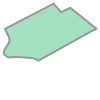

In [149]:
# get the first block group polygon in the data set
geo = philly_demo_final.iloc[0].geometry

geo

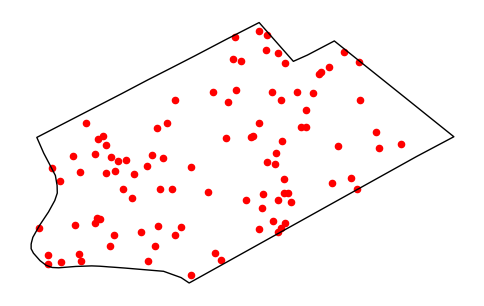

In [150]:
fig, ax = plt.subplots(figsize=(6, 6))

# Generate some random points
random_points = random_points_in_polygon(100, geo)

# Plot random points
gpd.GeoSeries(random_points).plot(ax=ax, markersize=20, color="red")

# Plot boundary of block group
gpd.GeoSeries([geo]).plot(ax=ax, facecolor="none", edgecolor="black")

ax.set_axis_off()

In [151]:
def generate_dot_map(data, people_per_dot):
    """
    Given a GeoDataFrame with demographic columns, generate a dot 
    map according to the population in each geometry.
    """
    results = []
    for field in ["White", "Hispanic", "Black", "Asian", "Other"]:

        # generate random points
        pts = data.apply(
            lambda row: random_points_in_polygon(
                row[field] / people_per_dot, row["geometry"]
            ),
            axis=1,
        )

        # combine into single GeoSeries
        pts = gpd.GeoSeries(pts.apply(pd.Series).stack(), dtype=object, crs=data["geometry"].crs)
        pts.name = "geometry"

        # make into a GeoDataFrame
        pts = gpd.GeoDataFrame(pts)
        pts["field"] = field

        # save
        results.append(pts)

    return gpd.GeoDataFrame(pd.concat(results), crs=data["geometry"].crs).reset_index(
        drop=True
    )

#### Calculate the dot map

In [152]:
dot_map = generate_dot_map(philly_demo_final, people_per_dot=50)

#### Now let's plot it

In [153]:
# setup a custom color map from ColorBrewer
from matplotlib.colors import ListedColormap


colors = {
    "Black": "steelblue",
    "White": "tomato",
    "Hispanic": "khaki",
    "Asian": "palegreen",
    "Other": "darkgray",
}

cmap = ListedColormap([t[1] for t in sorted(colors.items())])

In [154]:
# Convert to 3857
dot_map_3857 = dot_map.to_crs(epsg=3857)

In [155]:
# add zillow neighborhoods
zillow_neighborhoods = gpd.read_file("data/zillow_neighborhoods.geojson")

# Reproject the Zillow neighborhoods data to match the coordinate reference system (CRS) of dot_map_3857 if needed
zillow_neighborhoods = zillow_neighborhoods.to_crs(dot_map_3857.crs)

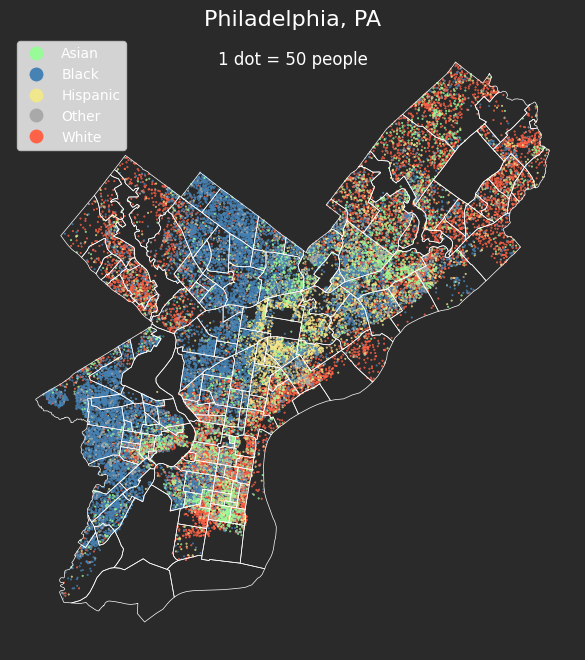

In [156]:
# Initialize the figure and axes
fig, ax = plt.subplots(figsize=(8, 8), facecolor="#2a2a2a")

# Plot
dot_map_3857.plot(
    ax=ax,
    column="field",
    categorical=True,
    legend=True,
    alpha=1,
    markersize=0.2,
    cmap=cmap,
    legend_kwds=dict(labelcolor="white"),
)

zillow_neighborhoods.plot(
    ax=ax,
    edgecolor="white",  # Color of Zillow neighborhood boundaries
    facecolor="none",    # Transparent fill
    linewidth=0.5        # Adjust line width as needed
)


# format
ax.set_title("Philadelphia, PA", fontsize=16, color="white")
ax.text(
    0.5,
    0.95,
    "1 dot = 50 people",
    fontsize=12,
    transform=ax.transAxes,
    ha="center",
    color="white",
)
ax.set_axis_off()

## That's it!

In [158]:
import folium
import geopandas as gpd

# Initialize the base map centered around Philadelphia
m = folium.Map(location=[39.9526, -75.1652], zoom_start=11, tiles="Cartodb dark_matter")

# Define the color mapping for each category
colors = {
    "Black": "steelblue",
    "White": "tomato",
    "Hispanic": "khaki",
    "Asian": "palegreen",
    "Other": "darkgray",
}

# Ensure dot_map_3857 CRS is WGS84 for folium
dot_map_3857 = dot_map_3857.to_crs(epsg=4326)

# Add dots to the map based on the "field" category
for _, row in dot_map_3857.iterrows():
    category = row["field"]
    color = colors.get(category, "gray")  # Default to gray if category not found
    folium.CircleMarker(
        location=[row.geometry.y, row.geometry.x],
        radius=1,
        color=color,
        fill=True,
        fill_opacity=0.5,
    ).add_to(m)

# Ensure Zillow neighborhoods CRS is WGS84 for folium
zillow_neighborhoods = zillow_neighborhoods.to_crs(epsg=4326)
folium.GeoJson(
    zillow_neighborhoods,
    style_function=lambda x: {
        'color': 'white',
        'weight': 0.5,
        'fillOpacity': 0
    }
).add_to(m)

# Add title and subtitle as a folium HTML popup
title_html = '''
     <h3 align="center" style="font-size:16px"><b>Philadelphia, PA</b></h3>
     <p align="center" style="font-size:12px">1 dot = 50 people</p>
     '''
m.get_root().html.add_child(folium.Element(title_html))

# Display the map
m
